In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy import signal
import os
from os.path import isfile, join
import operator
import math

### Harris Corner Detector from scratch

In [2]:
# Sobel and gaussian kernels defined here with numpy
# Sobel x-axis kernel
SOBEL_X = np.array((
    [-1, 0, 1],
    [-2, 0, 2],
    [-1, 0, 1]), dtype="int32")

# Sobel y-axis kernel
SOBEL_Y = np.array((
    [-1, -2, -1],
    [0, 0, 0],
    [1, 2, 1]), dtype="int32")

# Gaussian kernel
GAUSS = np.array((
    [1/16, 2/16, 1/16],
    [2/16, 4/16, 2/16],
    [1/16, 2/16, 1/16]), dtype="float64")
    

# Convolution function from scratch. 
def convolve(img, kernel):
    """
    Convolve function for odd dimensions.
    IT CONVOLVES IMAGES
    """
    if kernel.shape[0] % 2 != 1 or kernel.shape[1] % 2 != 1:
        raise ValueError("Only odd dimensions on filter supported")

    img_height = img.shape[0]
    img_width = img.shape[1]
    pad_height = kernel.shape[0] // 2
    pad_width = kernel.shape[1] // 2
    
    pad = ((pad_height, pad_height), (pad_height, pad_width))
    g = np.empty(img.shape, dtype=np.float64)
    img = np.pad(img, pad, mode='constant', constant_values=0)
    # Do convolution
    for i in np.arange(pad_height, img_height+pad_height):
        for j in np.arange(pad_width, img_width+pad_width):
            roi = img[i - pad_height:i + pad_height +
                      1, j - pad_width:j + pad_width + 1]
            g[i - pad_height, j - pad_width] = (roi*kernel).sum()

    if (g.dtype == np.float64):
        kernel = kernel / 255.0
        kernel = (kernel*255).astype(np.uint8)
    else:
        g = g + abs(np.amin(g))
        g = g / np.amax(g)
        g = (g*255.0)
    return g
    

def harris(img, threshold=0.6):

    img_cpy = img.copy() # copying image

    img1_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) # grayscaling (0-1)

    dx = convolve(img1_gray, SOBEL_X) # convolving with sobel filter on X-axis
    dy = convolve(img1_gray, SOBEL_Y) # convolving with sobel filter on Y-axis
    # square of derivatives
    dx2 = np.square(dx)
    dy2 = np.square(dy)

    dxdy = dx*dy #cross filtering
    # gauss filter for all directions (x,y,cross axis)
    g_dx2 = convolve(dx2, GAUSS)
    g_dy2 = convolve(dy2, GAUSS)
    g_dxdy = convolve(dxdy, GAUSS)
    # Harris Function
    harris = g_dx2*g_dy2 - np.square(g_dxdy) - 0.12*np.square(g_dx2 + g_dy2) # r(harris) = det - k*(trace**2)
    # Normalizing inside (0-1)
    cv2.normalize(harris, harris, 0, 1, cv2.NORM_MINMAX)

    # find all points above threshold (nonmax supression line)
    loc = np.where(harris >= threshold)
    # drawing filtered points
    for pt in zip(*loc[::-1]):
        cv2.circle(img_cpy, pt, 3, (255, 0, 0), -1)

    return img_cpy

(Text(0.5, 1.0, 'Harris Corner Output'), ([], []), ([], []))

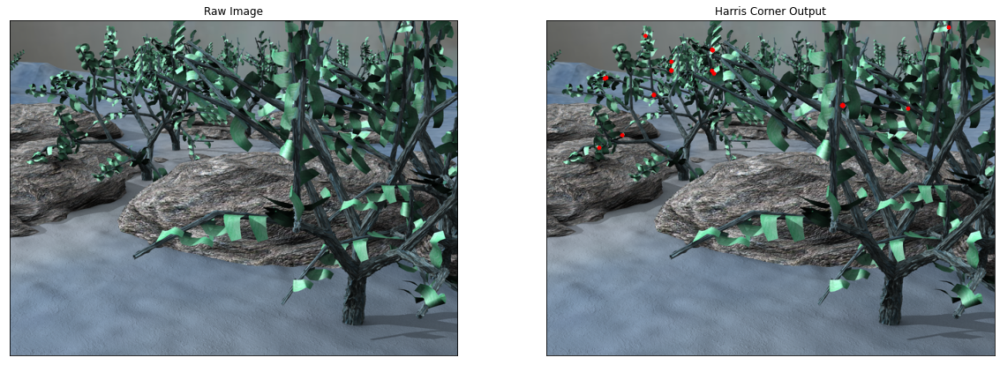

In [34]:
# Harris corner detector on Grove3 dataset's image
img = cv2.imread('../data/all-frames-colour/Grove3/frame07.png')
corners = harris(img,0.85)
plt.figure(figsize=(20, 20))
plt.subplot(121), plt.imshow(img)
plt.title("Raw Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(corners)
plt.title("Harris Corner Output"), plt.xticks([]), plt.yticks([])

(Text(0.5, 1.0, 'Harris Corner Output'), ([], []), ([], []))

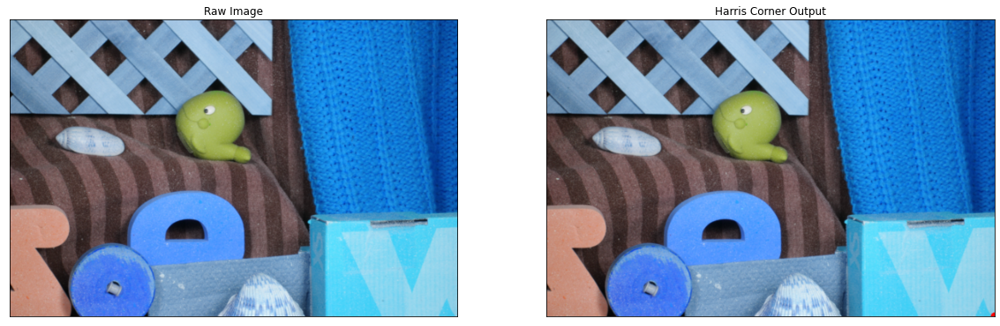

In [35]:
# Harris corner detector on RubberWhale dataset's image
img = cv2.imread('../data/all-frames-colour/RubberWhale/frame07.png')
corners = harris(img,0.85)
plt.figure(figsize=(20, 20))
plt.subplot(121), plt.imshow(img)
plt.title("Raw Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(corners)
plt.title("Harris Corner Output"), plt.xticks([]), plt.yticks([])

(Text(0.5, 1.0, 'Harris Corner Output'), ([], []), ([], []))

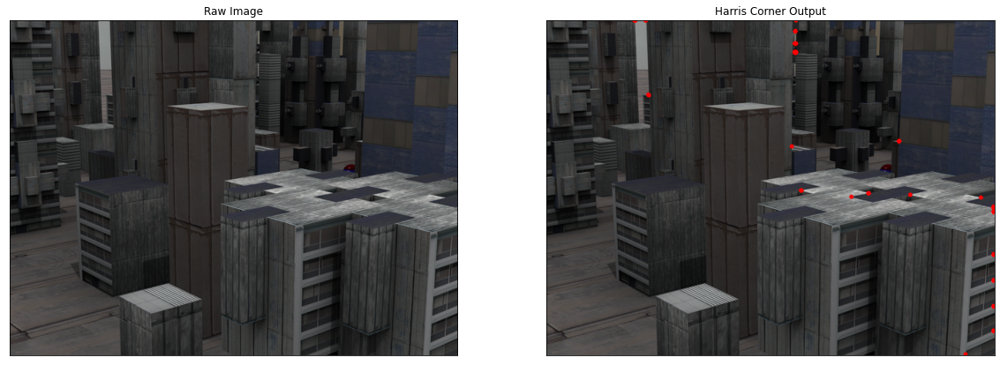

In [36]:
# Harris corner detector on Urban2 dataset's image
img = cv2.imread('../data/all-frames-colour/Urban2/frame07.png')
corners = harris(img,0.85)
plt.figure(figsize=(20, 20))
plt.subplot(121), plt.imshow(img)
plt.title("Raw Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(corners)
plt.title("Harris Corner Output"), plt.xticks([]), plt.yticks([])

### Shi-Tomasi Corner Detector from scratch

In [3]:
def findCorners(img, maxCor, thresh, dst):
    # Find x and y derivatives
    dy, dx = np.gradient(img)
    Ixx = dx ** 2
    Iyy = dy ** 2
    # Ixy = dy*dx

    height = img.shape[0]
    width = img.shape[1]
    offset = 0  # customizable window size offset

    cornerList = []
    # Search corners in image
    for y in range(offset, height - offset):
        for x in range(offset, width - offset):
            # Calculate sum of squares
            windowIxx = Ixx[y - offset:y + offset + 1, x - offset:x + offset + 1]
            windowIyy = Iyy[y - offset:y + offset + 1, x - offset:x + offset + 1]
            # windowIxy = Ixy[y-offset:y+offset+1, x-offset:x+offset+1]

            Sxx = windowIxx.sum()
            Syy = windowIyy.sum()
            r = min(Sxx, Syy)

            # Threshold for corner
            if r > thresh:
                cornerList.append([x, y, r])

    return filterCornersByDistance(cornerList, dst)[0:maxCor]


def filterCornersByDistance(cornerList, dist):
    cornerList.sort(key=operator.itemgetter(2), reverse=True)  # by r
    eFiltered = [cornerList[0]]
    for x in cornerList:
        bigger = True
        for y in eFiltered:
            # euclidean distance comparison
            if ((x[0] - y[0]) ** 2 + (x[1] - y[1]) ** 2) ** .5 <= dist:
                bigger = False
                break
        if bigger:
            eFiltered.append(x)
    return eFiltered


def Shi_Tomasi(color_img):
    # Specifying maximum number of corners as maxCorners
    # thresh is the minimum quality level below which the corners are rejected
    # dist is the minimum euclidean distance between two corners
    maxCorners = 100
    thresh = 0.1
    dist = 10

    corners = color_img.copy()
    img = cv2.cvtColor(corners, cv2.COLOR_RGB2GRAY)
    assignmentCorners = findCorners(img, maxCorners, thresh, dist)

    for corner in assignmentCorners:
        cv2.circle(corners, (corner[0], corner[1]), 3, 255, -1)

    return corners

(Text(0.5, 1.0, 'Shi Tomasi Corner Output'), ([], []), ([], []))

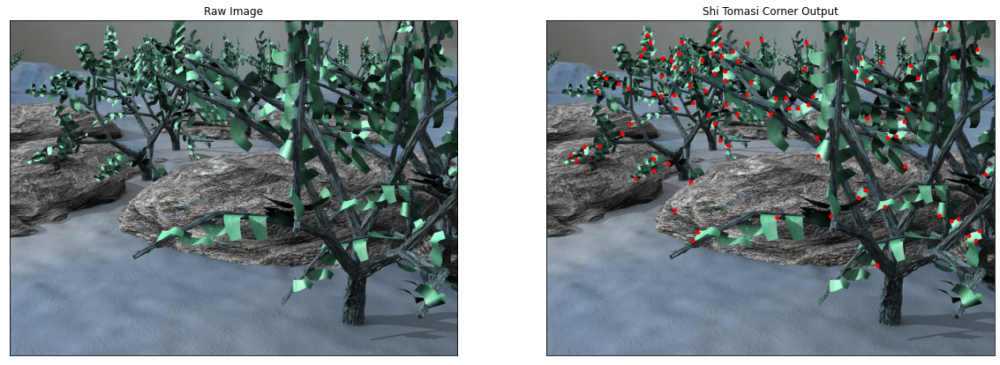

In [46]:
# Shi-Tomasi corner detector on Grove3 dataset's image
color_img = cv2.imread('../data/all-frames-colour/Grove3/frame07.png')
corners = Shi_Tomasi(color_img)

plt.figure(figsize=(20, 20))
plt.subplot(121), plt.imshow(color_img)
plt.title("Raw Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(corners)
plt.title("Shi Tomasi Corner Output"), plt.xticks([]), plt.yticks([])

(Text(0.5, 1.0, 'Shi Tomasi Corner Output'), ([], []), ([], []))

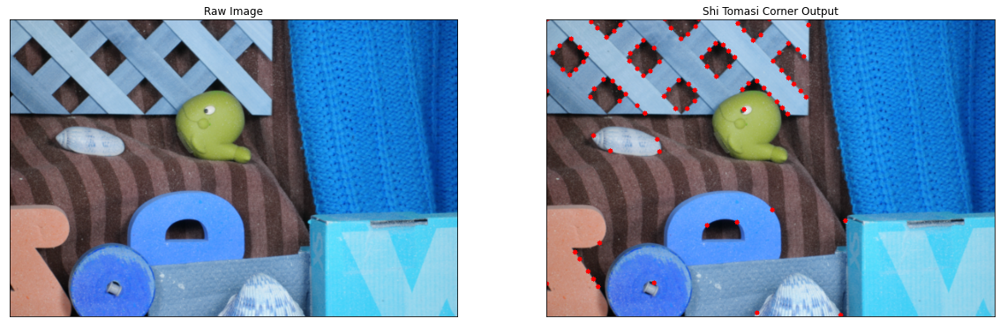

In [47]:
# Shi-Tomasi corner detector on RubberWhale dataset's image
color_img = cv2.imread('../data/all-frames-colour/RubberWhale/frame07.png')
corners = Shi_Tomasi(color_img)

plt.figure(figsize=(20, 20))
plt.subplot(121), plt.imshow(color_img)
plt.title("Raw Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(corners)
plt.title("Shi Tomasi Corner Output"), plt.xticks([]), plt.yticks([])

(Text(0.5, 1.0, 'Shi Tomasi Corner Output'), ([], []), ([], []))

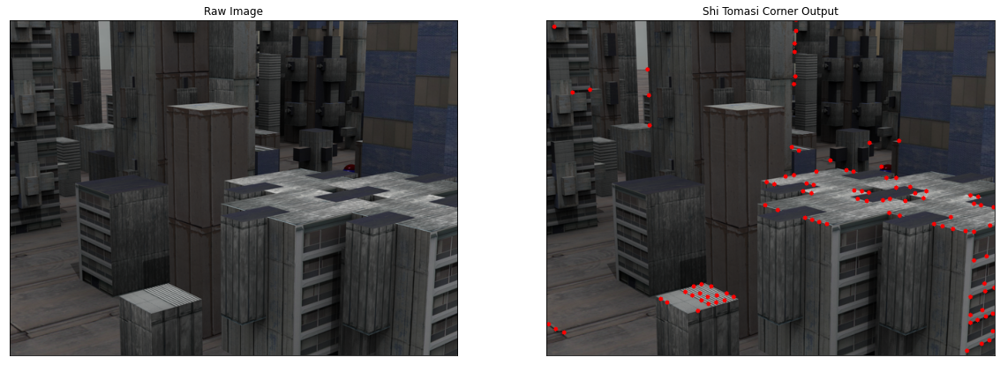

In [48]:
# Shi-Tomasi corner detector on Urban2 dataset's image
color_img = cv2.imread('../data/all-frames-colour/Urban2/frame07.png')
corners = Shi_Tomasi(color_img)

plt.figure(figsize=(20, 20))
plt.subplot(121), plt.imshow(color_img)
plt.title("Raw Image"), plt.xticks([]), plt.yticks([])
plt.subplot(122), plt.imshow(corners)
plt.title("Shi Tomasi Corner Output"), plt.xticks([]), plt.yticks([])

### Lucas-Kanade Algorithm

In [4]:
UNKNOWN_FLOW_THRESH = 1e7
def show_flow(filename):
    """
    visualize optical flow map using matplotlib
    :param filename: optical flow file
    :return: None
    """
    flow = read_flow(filename)
    img = flow_to_image(flow)
    plt.imshow(img)
    plt.show()

def read_flow(filename):
    """
    read optical flow from Middlebury .flo file
    :param filename: name of the flow file
    :return: optical flow data in matrix
    """
    f = open(filename, 'rb')
    magic = np.fromfile(f, np.float32, count=1)
    data2d = None

    if 202021.25 != magic:
        print ('Magic number incorrect. Invalid .flo file')
    else:
        w = int(np.fromfile(f, np.int32, count=1)[0])
        h = int(np.fromfile(f, np.int32, count=1)[0])
        #print("Reading %d x %d flo file" % (h, w))
        data2d = np.fromfile(f, np.float32, count=2 * w * h)
        # reshape data into 3D array (columns, rows, channels)
        data2d = np.resize(data2d, (h, w, 2))
    f.close()
    return data2d

def flow_to_image(flow):
    """
    Convert flow into middlebury color code image
    :param flow: optical flow map
    :return: optical flow image in middlebury color
    """
    u = flow[:, :, 0]
    v = flow[:, :, 1]

    maxu = -999.
    maxv = -999.
    minu = 999.
    minv = 999.

    idxUnknow = (abs(u) > UNKNOWN_FLOW_THRESH) | (abs(v) > UNKNOWN_FLOW_THRESH)
    u[idxUnknow] = 0
    v[idxUnknow] = 0

    maxu = max(maxu, np.max(u))
    minu = min(minu, np.min(u))

    maxv = max(maxv, np.max(v))
    minv = min(minv, np.min(v))

    rad = np.sqrt(u ** 2 + v ** 2)
    maxrad = max(-1, np.max(rad))

    u = u/(maxrad + np.finfo(float).eps)
    v = v/(maxrad + np.finfo(float).eps)

    img = compute_color(u, v)

    idx = np.repeat(idxUnknow[:, :, np.newaxis], 3, axis=2)
    img[idx] = 0

    return np.uint8(img)


def compute_color(u, v):
    """
    compute optical flow color map
    :param u: optical flow horizontal map
    :param v: optical flow vertical map
    :return: optical flow in color code
    """
    [h, w] = u.shape
    img = np.zeros([h, w, 3])
    nanIdx = np.isnan(u) | np.isnan(v)
    u[nanIdx] = 0
    v[nanIdx] = 0

    colorwheel = make_color_wheel()
    ncols = np.size(colorwheel, 0)

    rad = np.sqrt(u**2+v**2)

    a = np.arctan2(-v, -u) / np.pi

    fk = (a+1) / 2 * (ncols - 1) + 1

    k0 = np.floor(fk).astype(int)

    k1 = k0 + 1
    k1[k1 == ncols+1] = 1
    f = fk - k0

    for i in range(0, np.size(colorwheel,1)):
        tmp = colorwheel[:, i]
        col0 = tmp[k0-1] / 255
        col1 = tmp[k1-1] / 255
        col = (1-f) * col0 + f * col1

        idx = rad <= 1
        col[idx] = 1-rad[idx]*(1-col[idx])
        notidx = np.logical_not(idx)

        col[notidx] *= 0.75
        img[:, :, i] = np.uint8(np.floor(255 * col*(1-nanIdx)))

    return img


def make_color_wheel():
    """
    Generate color wheel according Middlebury color code
    :return: Color wheel
    """
    RY = 15
    YG = 6
    GC = 4
    CB = 11
    BM = 13
    MR = 6

    ncols = RY + YG + GC + CB + BM + MR

    colorwheel = np.zeros([ncols, 3])

    col = 0

    # RY
    colorwheel[0:RY, 0] = 255
    colorwheel[0:RY, 1] = np.transpose(np.floor(255*np.arange(0, RY) / RY))
    col += RY

    # YG
    colorwheel[col:col+YG, 0] = 255 - np.transpose(np.floor(255*np.arange(0, YG) / YG))
    colorwheel[col:col+YG, 1] = 255
    col += YG

    # GC
    colorwheel[col:col+GC, 1] = 255
    colorwheel[col:col+GC, 2] = np.transpose(np.floor(255*np.arange(0, GC) / GC))
    col += GC

    # CB
    colorwheel[col:col+CB, 1] = 255 - np.transpose(np.floor(255*np.arange(0, CB) / CB))
    colorwheel[col:col+CB, 2] = 255
    col += CB

    # BM
    colorwheel[col:col+BM, 2] = 255
    colorwheel[col:col+BM, 0] = np.transpose(np.floor(255*np.arange(0, BM) / BM))
    col += + BM

    # MR
    colorwheel[col:col+MR, 2] = 255 - np.transpose(np.floor(255 * np.arange(0, MR) / MR))
    colorwheel[col:col+MR, 0] = 255

    return colorwheel

In [5]:
def display_opticalflow_results(im1,im2,u,v,cnt,arrow_thres=0.02):
    """
        Display results of optical flow
        @param img_list:=> mxn matrix of images to be displayed
        @param shape:=> mxn shape
        @param is_gray:=> mxn matrix, is the i,j th the image grayscaled
    
        return None
    """
    fig_size=(16,16)
    fig = plt.figure(figsize=fig_size)
    
    #     Images
    ax = fig.add_subplot(3,2,1)
    ax.imshow(im1,cmap='gray')
    ax.set_title("Image T:{}".format(cnt))
    ax.axis('off')
    
    ax = fig.add_subplot(3,2,2)
    ax.imshow(im2,cmap='gray')
    ax.set_title("Image T:{}".format(cnt+1))
    ax.axis('off')
    
    # Vectors     
    ax = fig.add_subplot(3,2,3)
    ax.imshow(u,cmap='gray')
    ax.set_title("U")
    ax.axis('off')
    
    ax = fig.add_subplot(3,2,4)
    ax.imshow(v,cmap='gray')
    ax.set_title("V")
    ax.axis('off')

    ax = fig.add_subplot(3,2,5)
    ax.set_title("Optical flow Arrows")
    ax.imshow(im1,cmap='gray')
    kp = cv2.goodFeaturesToTrack(im1, 100, 0.01, 10, 3)
    for arrow_ind in kp:
        x,y = arrow_ind[0]
        y = int(y)
        x = int(x)
        ax.arrow(x,y,u[y,x],v[y,x],head_width = 5, head_length = 10, color = (0,1,0))
    
    ax.axis('off')

    ax = fig.add_subplot(3,2,6)
    img = compute_color(u,v)
    img = (img * 255).astype(np.uint8)
    ax.imshow(img)
    ax.set_title("Flow Representation")
    ax.axis('off')
    plt.show()

    # return temp


# 2d Convolution
def conv2d(a, f,pad=True):
    """
        Run 2d Convolution on a Matrix using the filter f
        @param a:=> 2d Matrix
        @param f:=> filter (list or numpy array)
        
        return convolved matrix  
    """
    f = np.array(f)
    s = f.shape + tuple(np.subtract(a.shape, f.shape) + 1)
    strd = np.lib.stride_tricks.as_strided
    subM = strd(a, shape = s, strides = a.strides * 2)
    return np.einsum('ij,ijkl->kl', f, subM)


def optical_flow(I1g, I2g, window_size, tau=1e-2):
#     Define our kernels to calculate gradients
    kernel_x = np.array([[-1., 1.], [-1., 1.]])
    kernel_y = np.array([[-1., -1.], [1., 1.]])
    kernel_t = np.array([[1., 1.], [1., 1.]])#*.25
    w = window_size//2 # window_size is odd, all the pixels with offset in between [-w, w] are inside the window
    I1g = I1g / 255. # normalize pixels
    I2g = I2g / 255. # normalize pixels
    # Implement Lucas Kanade
    # for each point, calculate I_x, I_y, I_t by conv2d
    fx = signal.convolve2d(I1g, kernel_x, boundary='symm', mode='same')
    fy = signal.convolve2d(I1g, kernel_y, boundary='symm', mode='same')
    ft = signal.convolve2d(I2g, kernel_t, boundary='symm', mode='same') + signal.convolve2d(I1g, -kernel_t, boundary='symm', mode='same')
    u = np.zeros(I1g.shape)
    v = np.zeros(I1g.shape)
    
    # For each window calculate the vectors [u,v]    
    # within windw window_size * window_size
    for i in range(w, I1g.shape[0]-w):
        for j in range(w, I1g.shape[1]-w):
            Ix = fx[i-w:i+w+1, j-w:j+w+1].flatten()
            Iy = fy[i-w:i+w+1, j-w:j+w+1].flatten()
            It = ft[i-w:i+w+1, j-w:j+w+1].flatten()
            
            A = [ [ np.sum(Ix*Ix),np.sum(Ix*Iy)], [np.sum(Iy*Ix), np.sum(Iy*Iy)] ]
            A = np.array(A)
    
            b = [-np.sum(Ix*It), -np.sum(Iy*It)]
            b = np.array(b)
            
            # if threshold τ is larger than the smallest eigenvalue of A'A:
            print(A)
            U,D,V_T = np.linalg.svd(A.T.dot(A))
            if np.min(D) < tau:
                u[i,j]=0
                v[i,j]=0                
            
            else:
                try:
                    nu = np.linalg.inv(A).dot(b)
                    u[i,j]=nu[0]
                    v[i,j]=nu[1]
                except Exception as e:
                    print(A,D,e)
                
    return [u,v]


def fxn(img_dir,save_in_dir):
    # clearing anything available in the save_in_dir directory
    all_imgs = os.listdir(save_in_dir)
    for img in all_imgs:
        os.remove(os.path.join(save_in_dir,img))

    all_imgs = os.listdir(img_dir)
    length = len(all_imgs)

    img_pair_list = []
    for i in range(length):
        if i < length - 1:
            img1_path = os.path.join(img_dir,all_imgs[i])
            img2_path = os.path.join(img_dir,all_imgs[i+1])
            img_pair_list.append([img1_path, img2_path])

    # Calculate optical flow on images
    cnt = 1
    for image_pair in img_pair_list:
        img1_path ,img2_path = image_pair
        img1 = cv2.imread(img1_path,0)
        img2 = cv2.imread(img2_path,0)
        # window size is kept 5.
        u,v = optical_flow(img1,img2,window_size=5)
        display_opticalflow_results(img1,img2,u,v,cnt,arrow_thres=1)
        cnt += 1

In [ ]:
img1 = cv2.imread('../data/all-frames-colour/Urban2/frame07.png',0)
img2 = cv2.imread('../data/all-frames-colour/Urban2/frame08.png',0)

u, v= optical_flow(img1,img2,5)


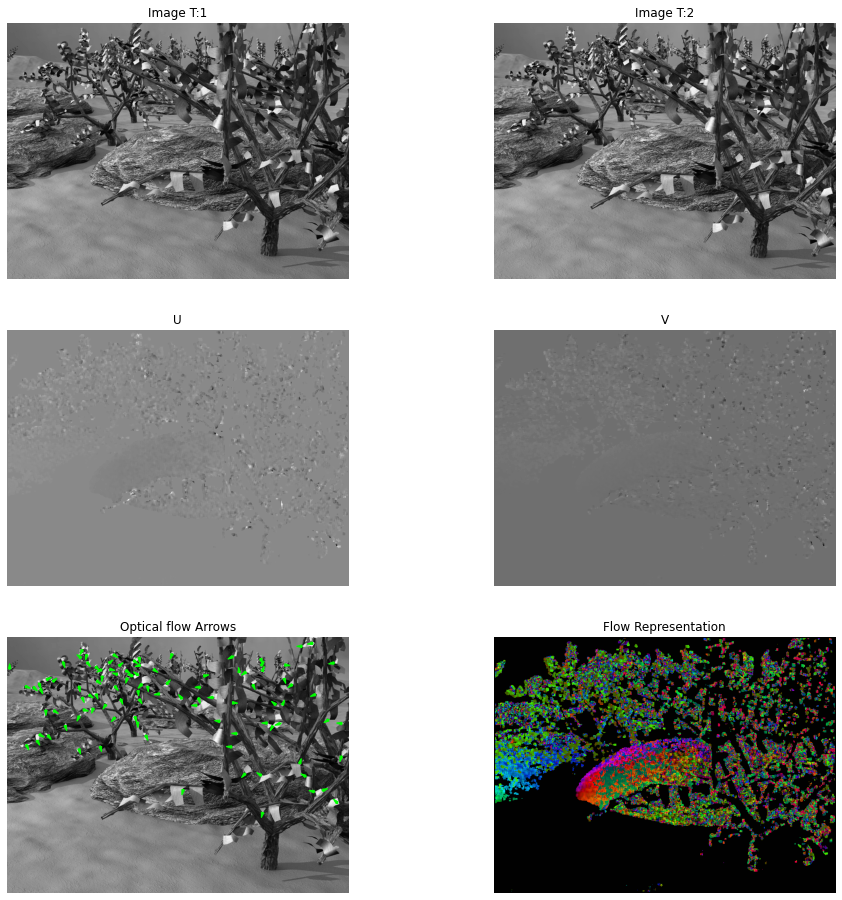

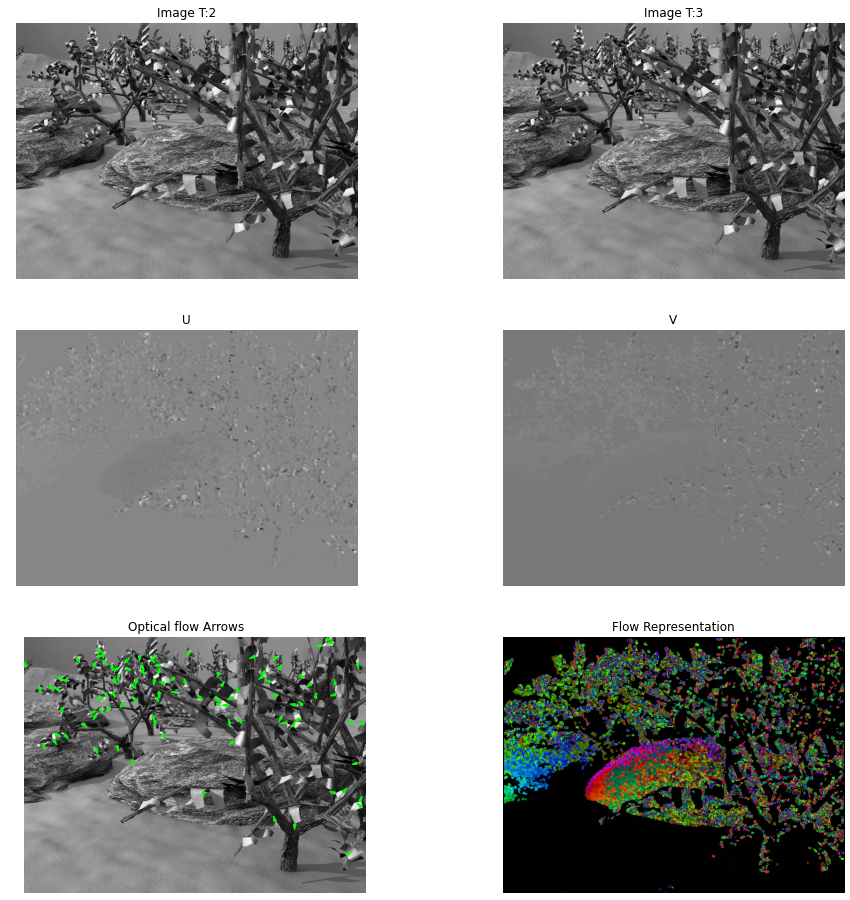

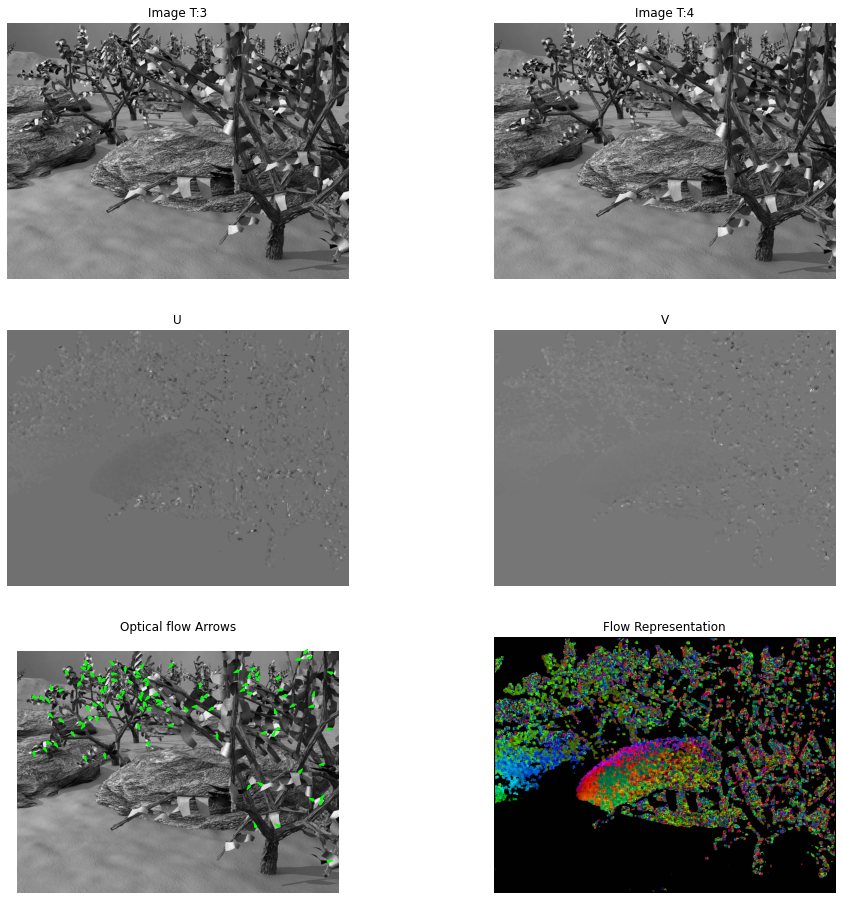

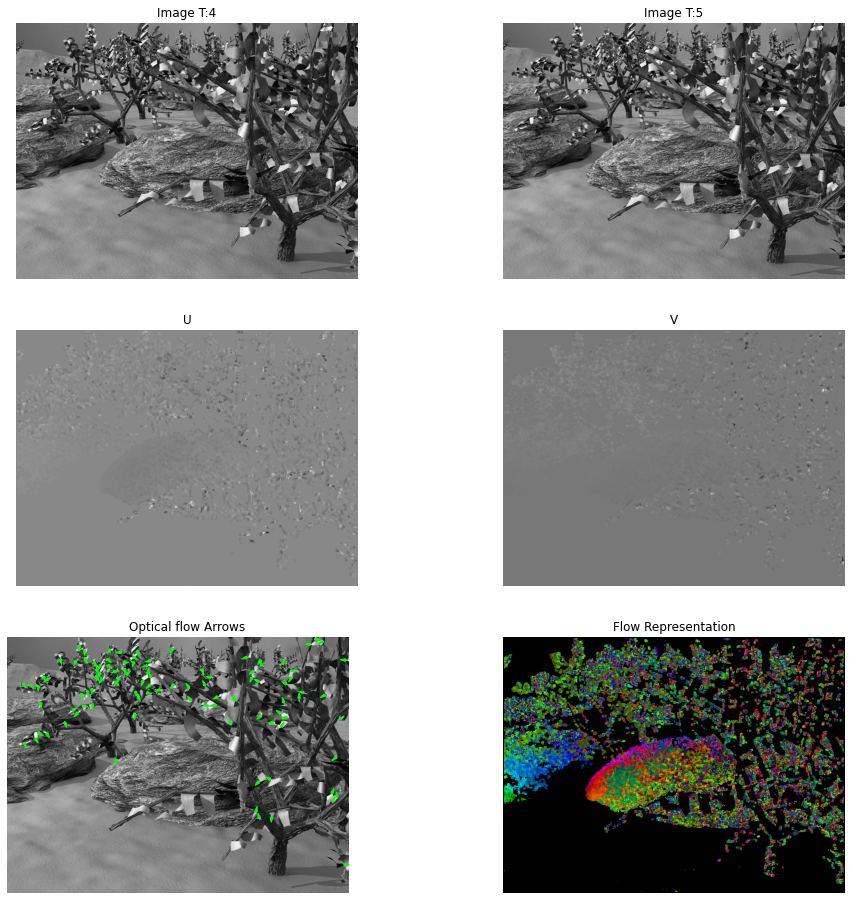

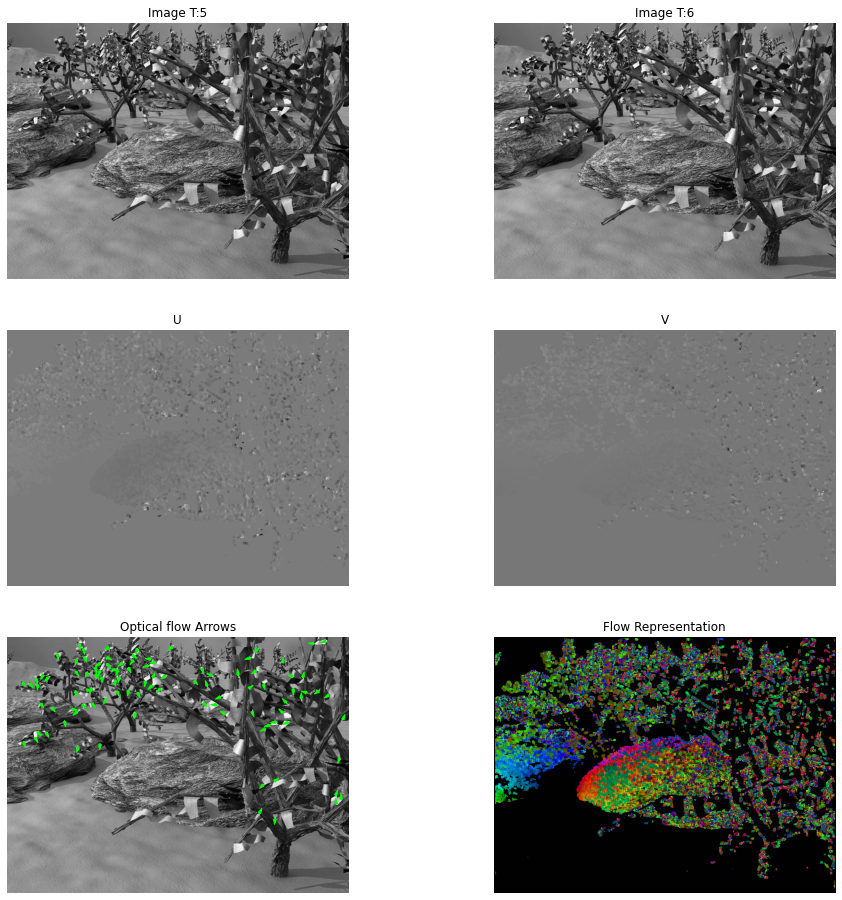

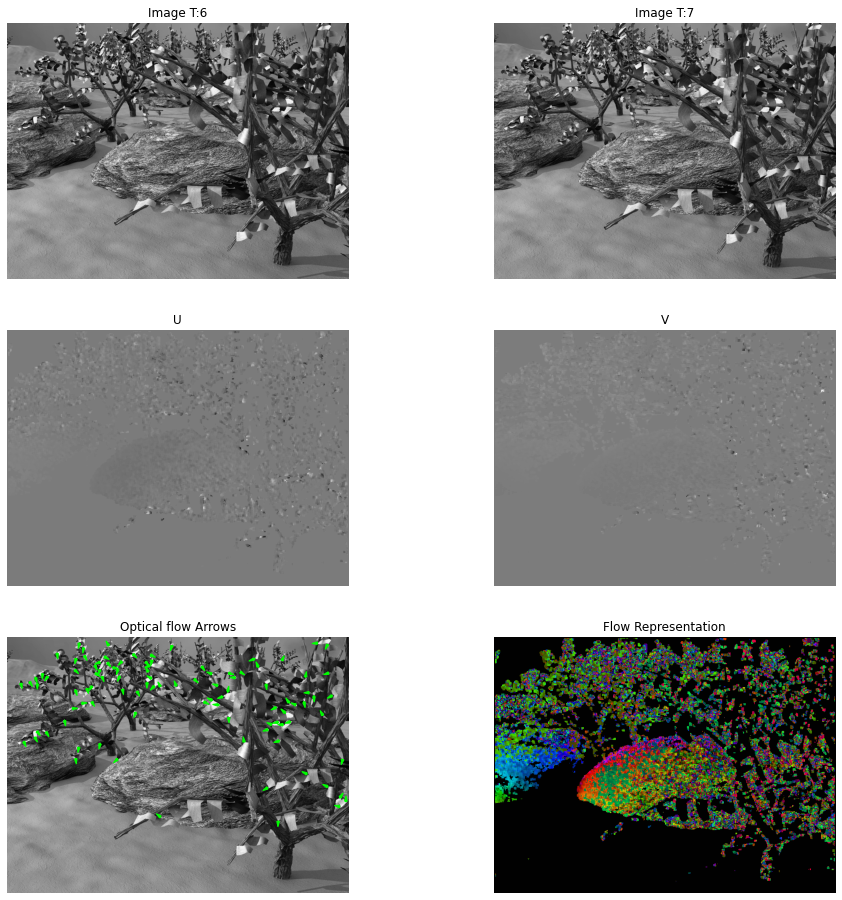

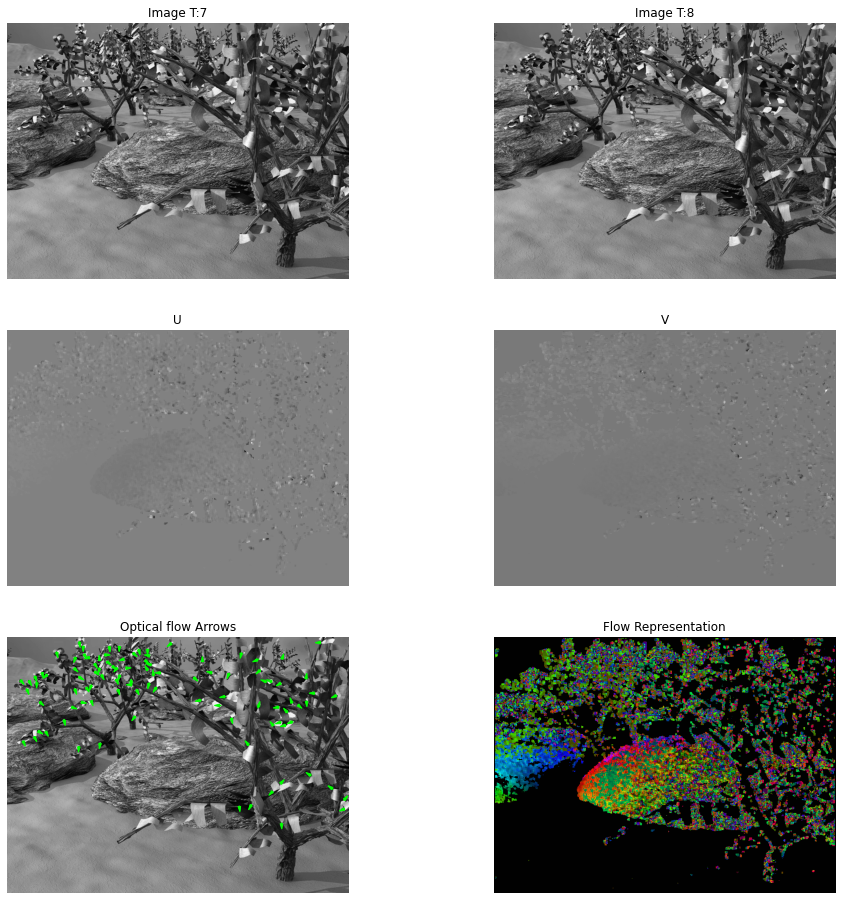

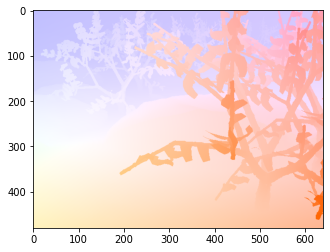

In [35]:
fxn('../data/all-frames-colour/Grove3','../results/Grove3_opticalflow')
show_flow('../data/ground-truth-flow/Grove3/flow10.flo')

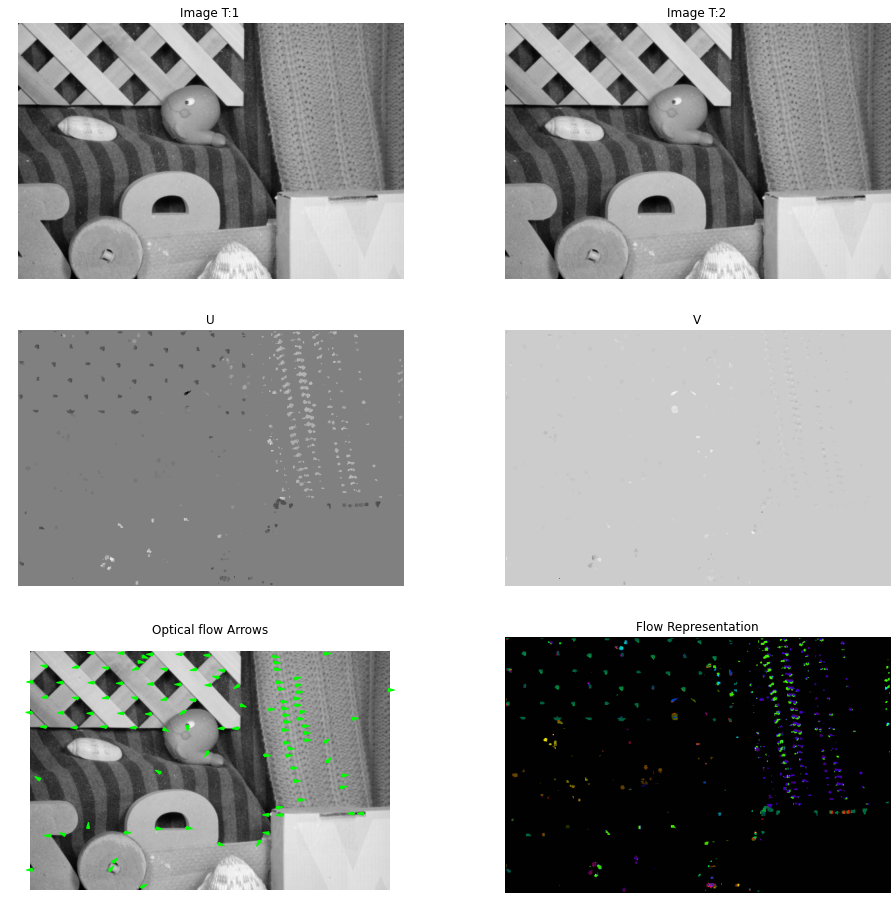

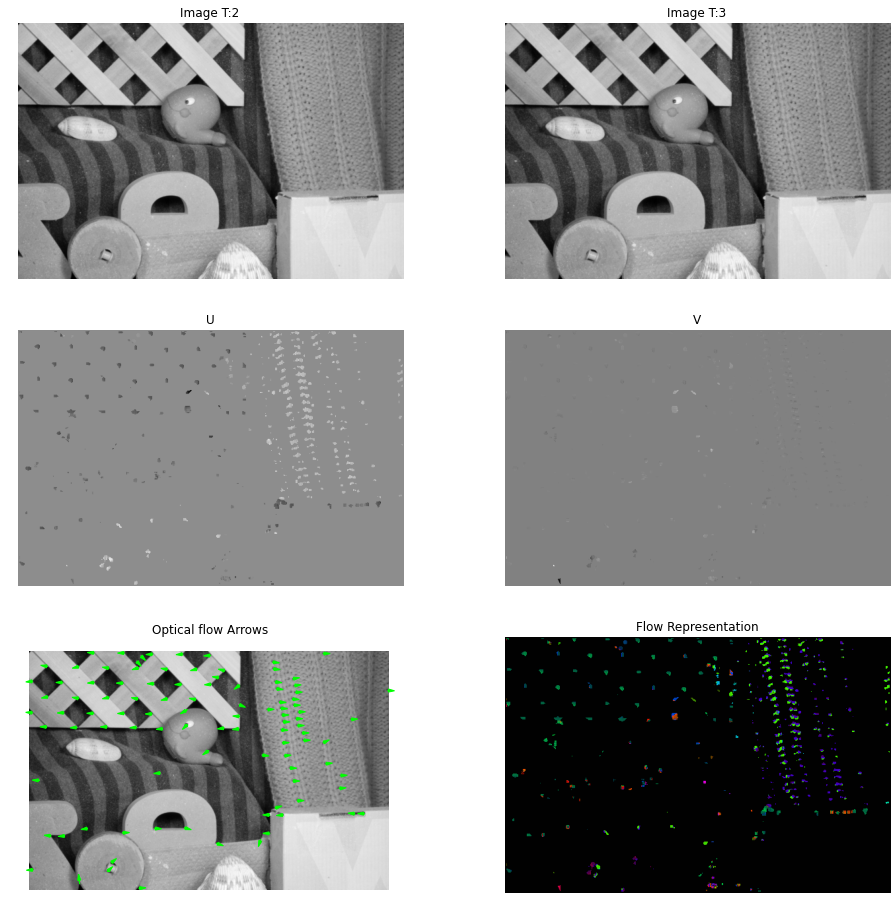

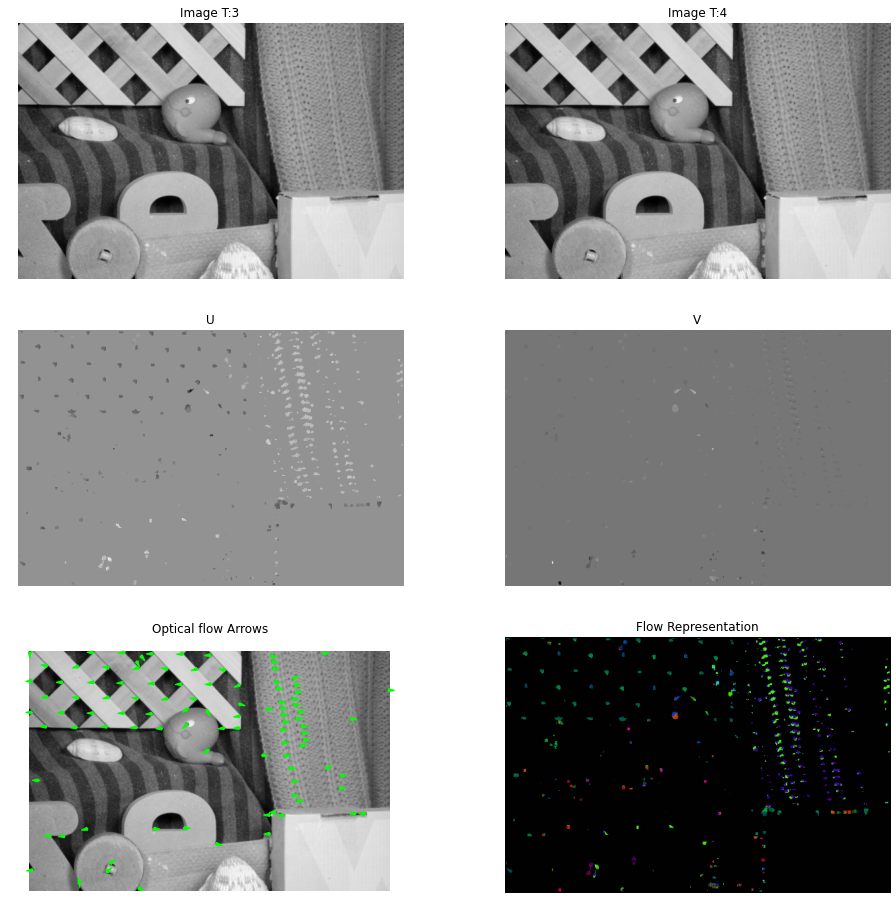

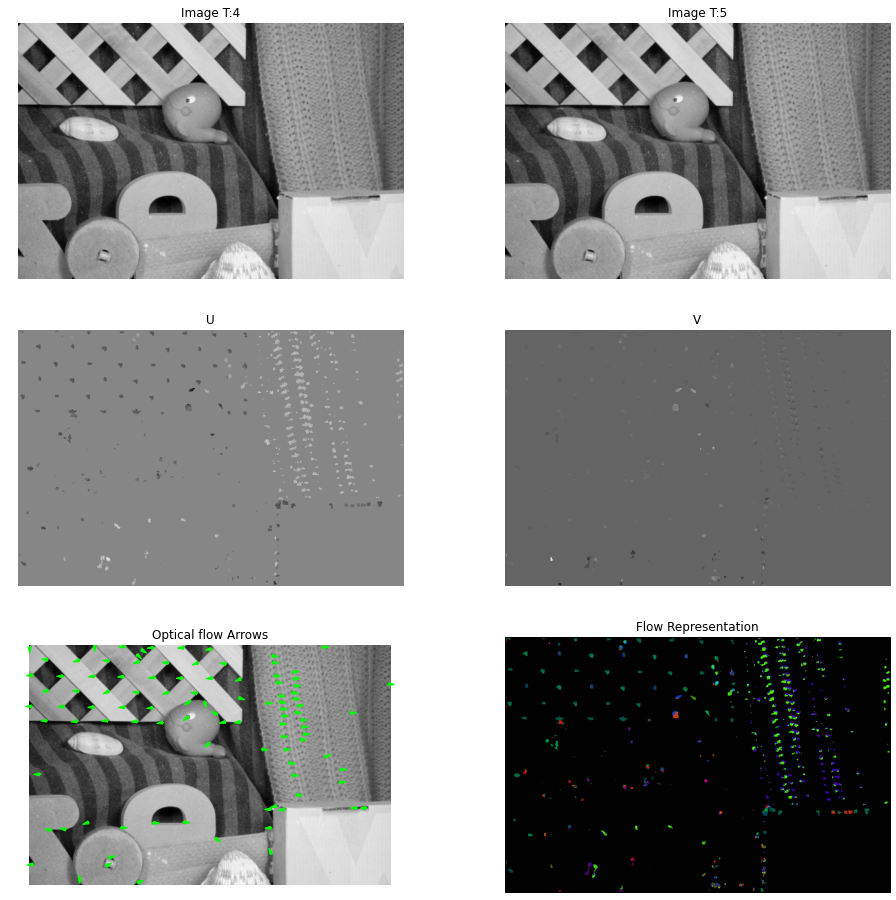

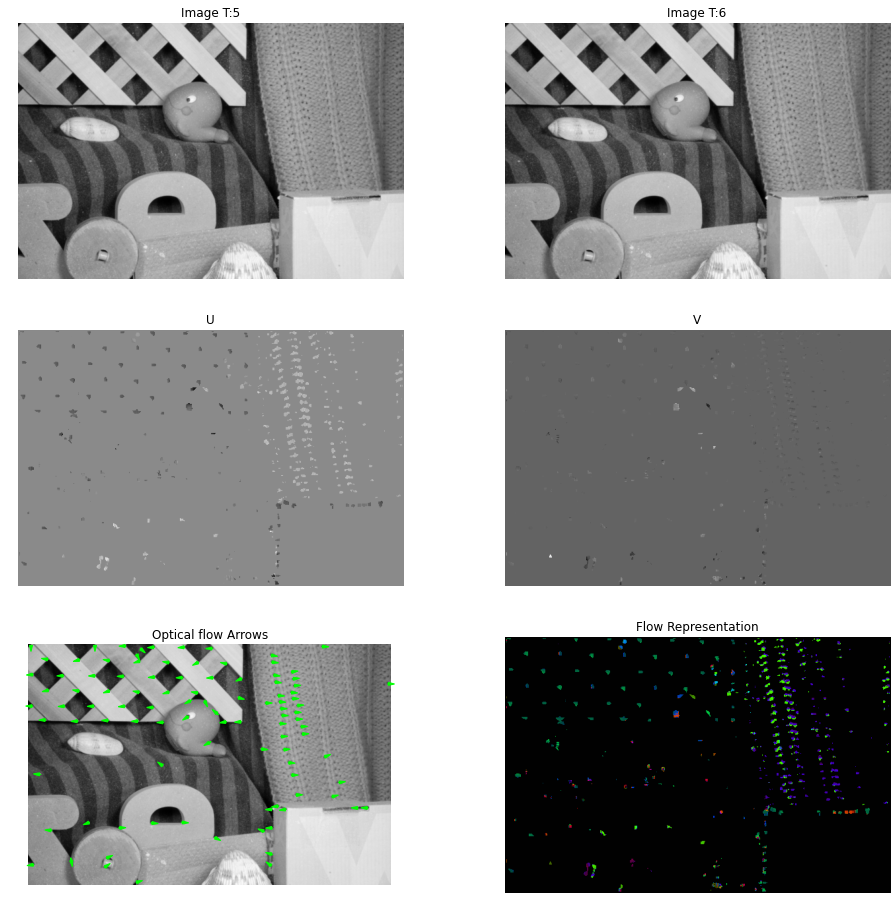

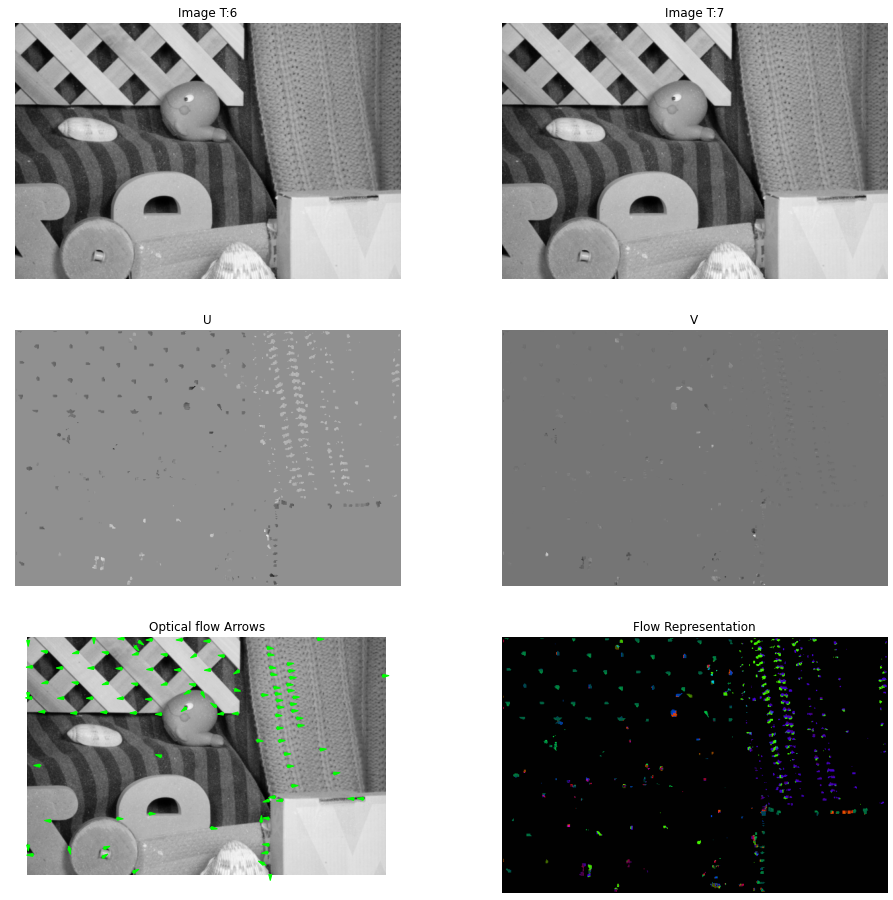

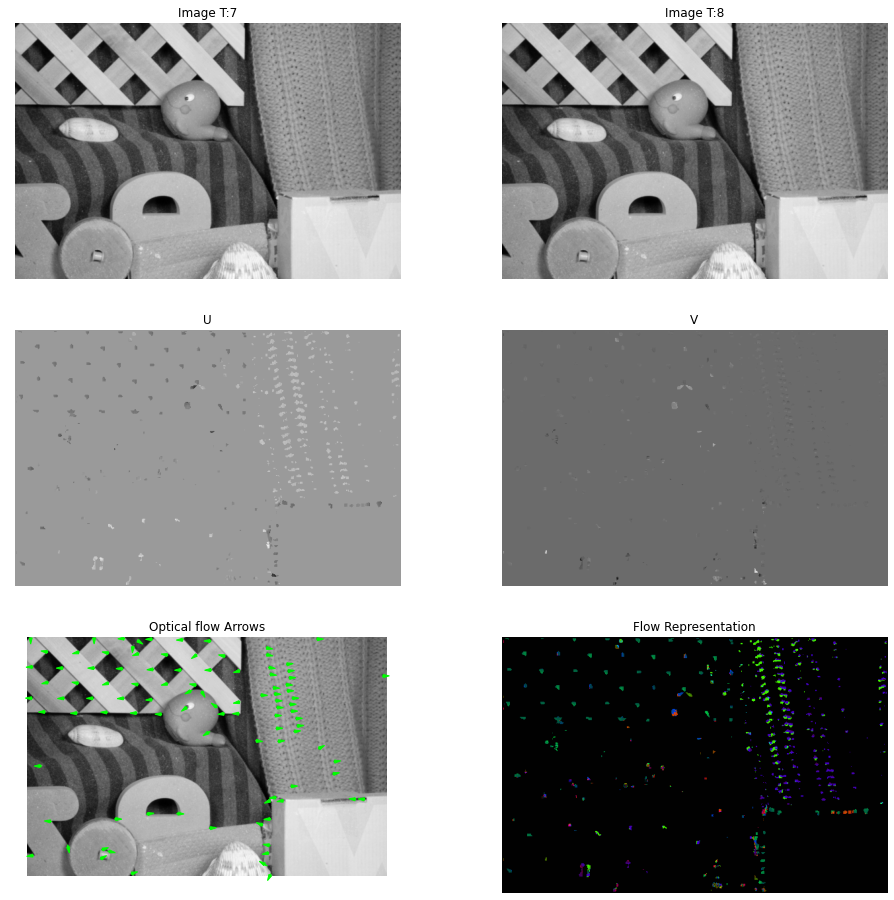

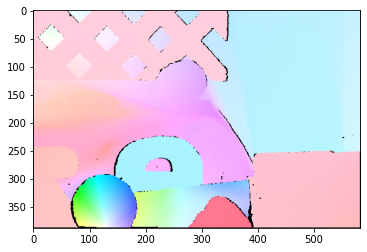

In [36]:
fxn('../data/all-frames-colour/RubberWhale','../results/RubberWhale_opticalflow')
show_flow('../data/ground-truth-flow/RubberWhale/flow10.flo')

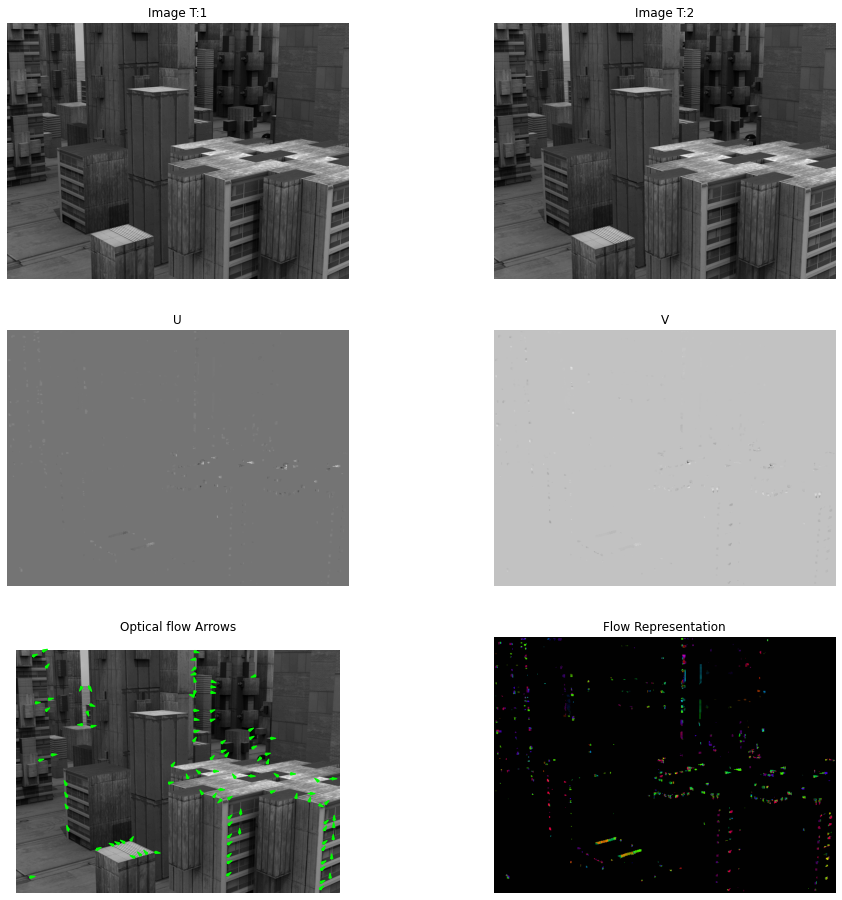

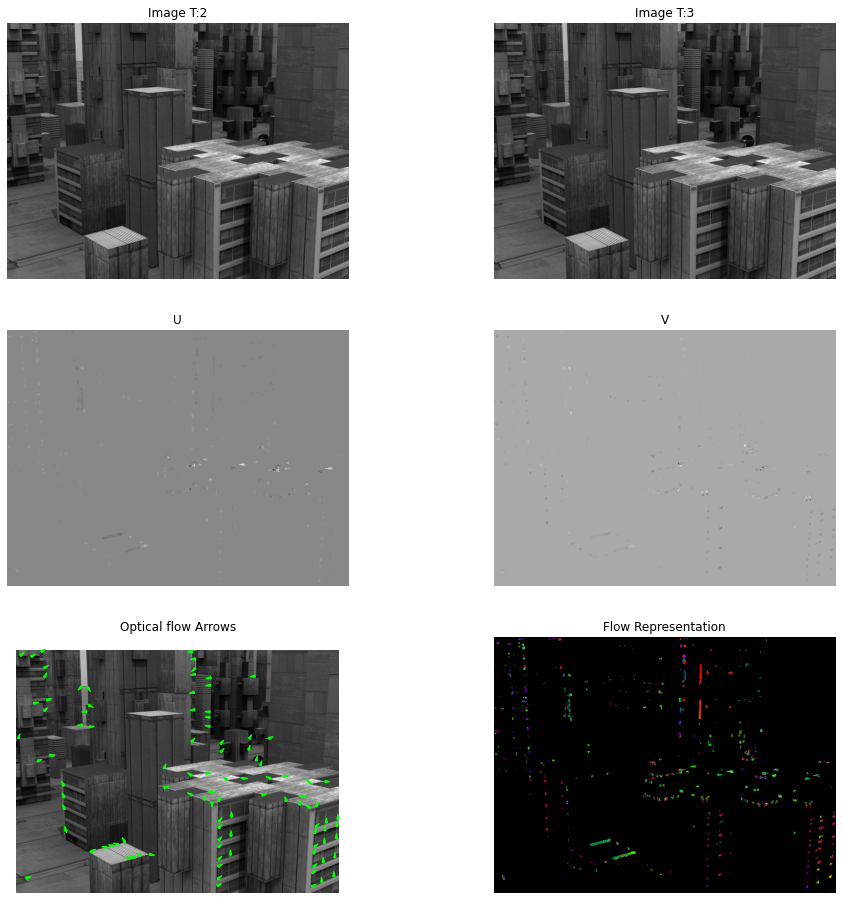

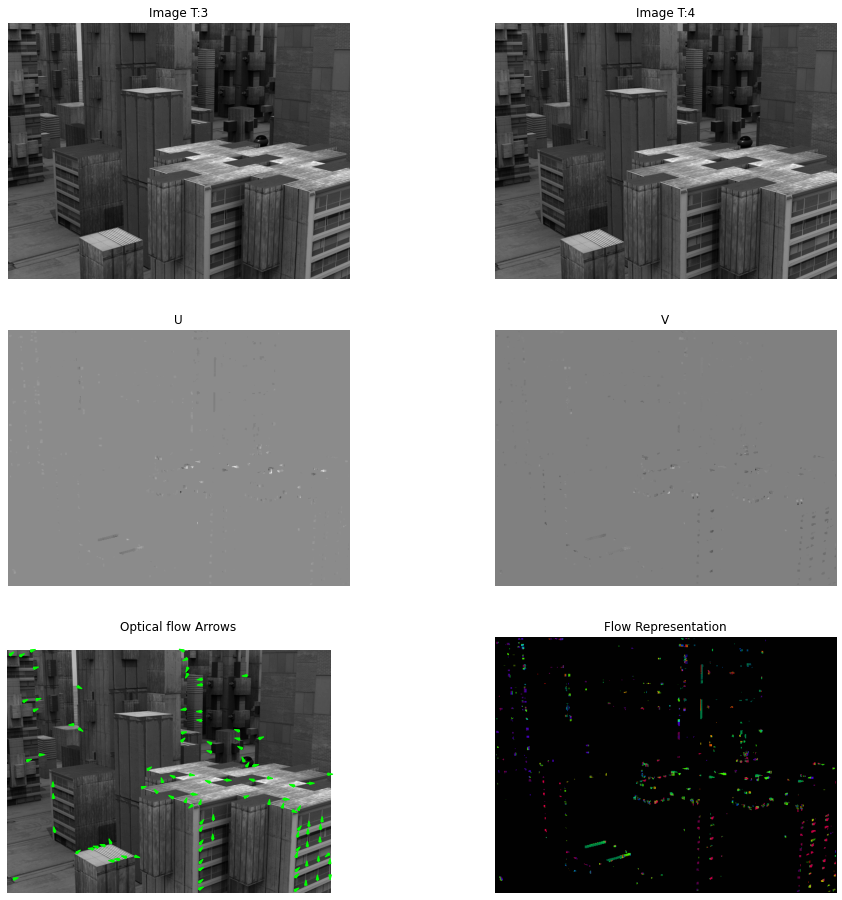

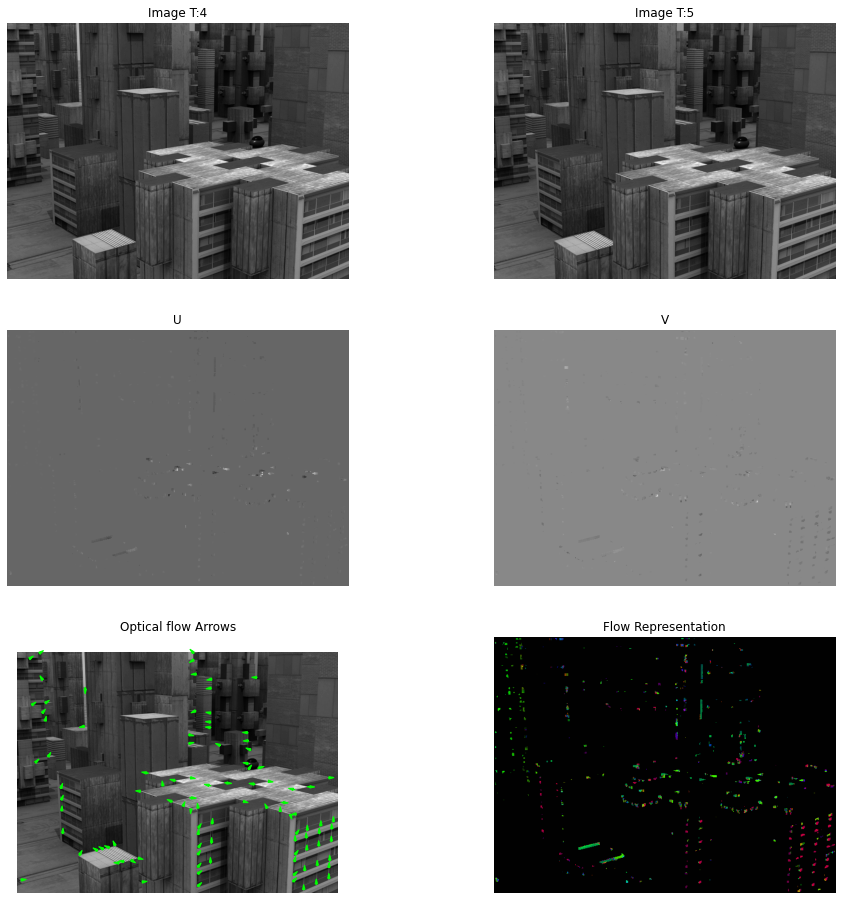

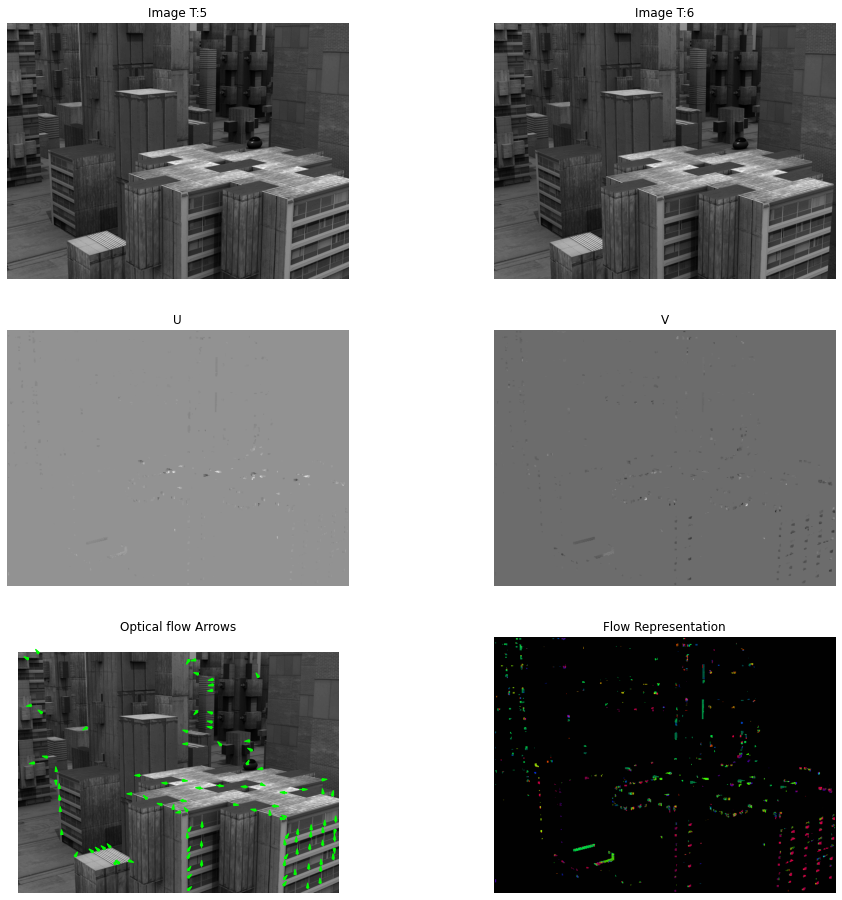

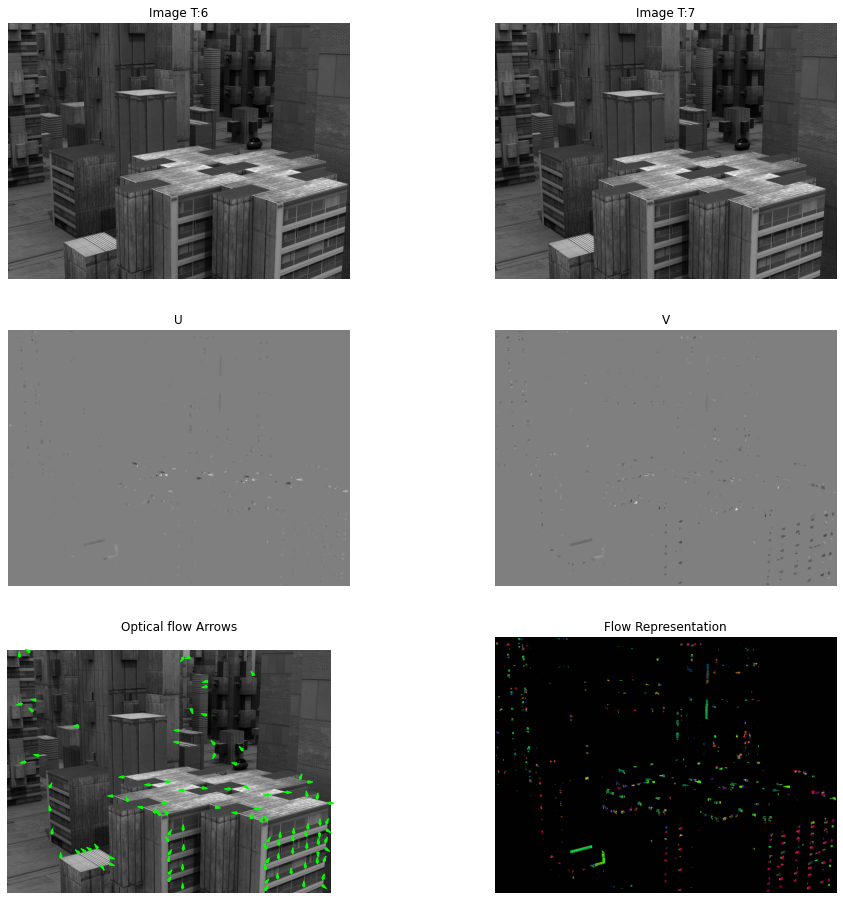

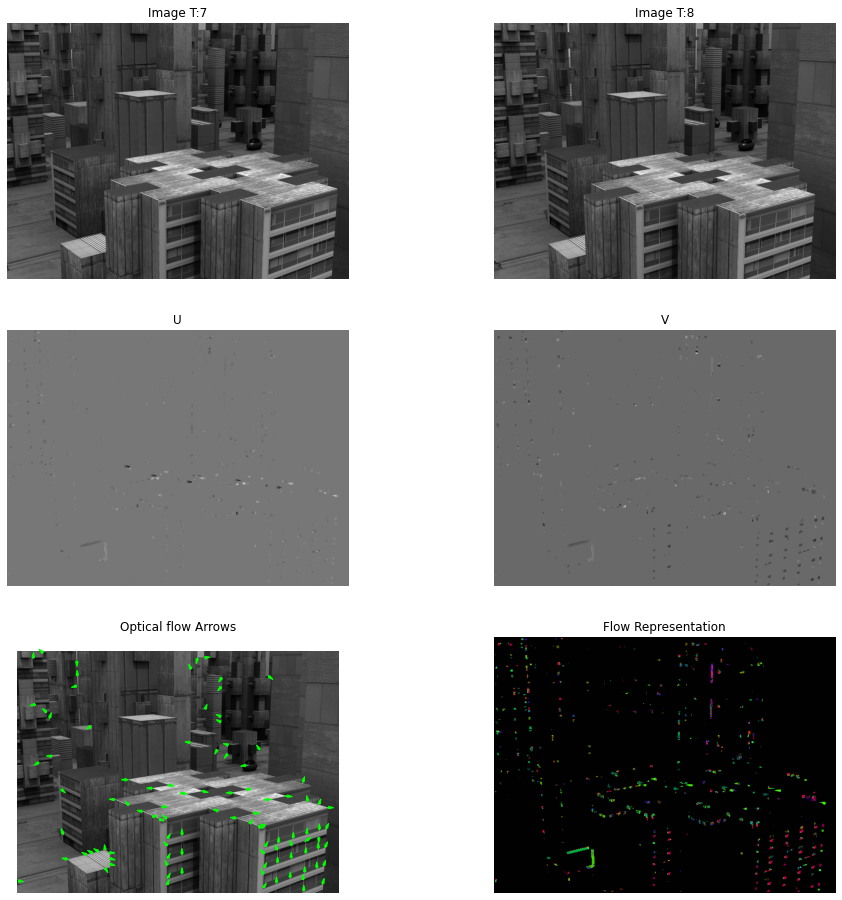

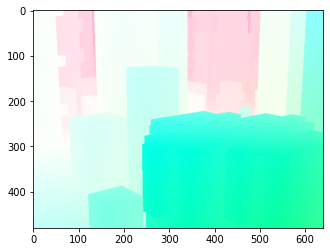

In [37]:
fxn('../data/all-frames-colour/Urban2','../results/Urban2_opticalflow')
show_flow('../data/ground-truth-flow/Urban2/flow10.flo')

### Average End Point Error

In [16]:
def average_end_point_error(flo_file_path, img1_path, img2_path,multi_flag):
    ground_truth = read_flow(flo_file_path)

    # 10th and 11th image, because ground truth is available for it only
    img1 = cv2.imread(img1_path,0)
    img2 = cv2.imread(img2_path,0)
    
    if multi_flag == True:
        u, v = MultiScaleLucasKanade(img1,img2,5,5)
    else:
        u, v = optical_flow(img1,img2,window_size=5)

    h,w = u.shape
    img1 = cv2.resize(img1, (w,h))
    img2 = cv2.resize(img2, (w,h))

    epe = 0.0

    for i in range(h):
        for j in range(w):
            epe += math.sqrt((ground_truth[i][j][0] - u[i][j])**2 + (ground_truth[i][j][1] - v[i][j])**2)

    # calculating average epe
    aepe = epe/(h*w)
    return aepe

In [17]:
aepe = average_end_point_error('../data/ground-truth-flow/Grove3/flow10.flo', '../data/all-frames-colour/Grove3/frame10.png', '../data/all-frames-colour/Grove3/frame11.png',0)
print('Average End Point Error in Grove3 dataset is: ', aepe)

aepe = average_end_point_error('../data/ground-truth-flow/RubberWhale/flow10.flo', '../data/all-frames-colour/RubberWhale/frame10.png', '../data/all-frames-colour/RubberWhale/frame11.png',0)
print('\nAverage End Point Error in RubberWhale dataset is: ', aepe)

aepe = average_end_point_error('../data/ground-truth-flow/Urban2/flow10.flo', '../data/all-frames-colour/Urban2/frame10.png', '../data/all-frames-colour/Urban2/frame10.png',0)
print('Average End Point Error in Urban2 dataset is: ', aepe)

Average End Point Error in Grove3 dataset is:  4.235534880391213

Average End Point Error in RubberWhale dataset is:  37676248.93318456
Average End Point Error in Urban2 dataset is:  8.393366785270416


### Multi-Scale Coarse-to-fine Optical Flow

In [12]:
# taking windowSize as 5 and taking numLevels as 5
def OpticalFlowRefine(img1,img2,windowSize, u0, v0):
    new_img2 = np.zeros(img2.shape)
    u = np.zeros(img2.shape)
    v = np.zeros(img2.shape)

    h, w = img2.shape
    for i in range(h):
        for j in range(w):
            u_ij = int(u0[i][j])
            v_ij = int(v0[i][j])
            if i+u_ij>=0 and i+u_ij<h and j+v_ij>=0 and j+v_ij<w:
                new_img2[i][j] = img2[i+u_ij][j+v_ij]

    
    del_u, del_v = optical_flow(img1,new_img2,window_size=5)
  
    for i in range(h):
        for j in range(w):
            u[i][j] = u0[i][j] + del_u[i][j]
            v[i][j] = v0[i][j] + del_v[i][j]

    return [u,v]


def MultiScaleLucasKanade(img1,img2,windowSize,numLevels):
    img1 = cv2.GaussianBlur(img1,(5,5),cv2.BORDER_DEFAULT)
    img2 = cv2.GaussianBlur(img2,(5,5),cv2.BORDER_DEFAULT)
    factor = pow(2,1-numLevels)
    h,w = img1.shape
    # scaling by a factor of 2ˆ(1 - numLevels)
    h = int(h*factor)
    w = int(w*factor)
    img1 = cv2.resize(img1, (h,w))
    img2 = cv2.resize(img2, (h,w))

    prev_u, prev_v = optical_flow(img1,img2,5)

    for _ in range(numLevels):
        h,w = img1.shape
        new_img1 = cv2.resize(img1, (h*2,w*2))
        new_img2 = cv2.resize(img2, (h*2,w*2))

        h, w= prev_u.shape
        prev_u = cv2.resize(prev_u, (h*2,w*2))
        prev_v = cv2.resize(prev_v, (h*2,w*2))

        u, v = OpticalFlowRefine(new_img1,new_img2,5,prev_u,prev_v)

        prev_u = u
        prev_v = v

    return [u,v]



def fxn_for_multi(img_dir):
    all_imgs = os.listdir(img_dir)
    length = len(all_imgs)

    img_pair_list = []
    for i in range(length):
        if i < length - 1:
            img1_path = os.path.join(img_dir,all_imgs[i])
            img2_path = os.path.join(img_dir,all_imgs[i+1])
            img_pair_list.append([img1_path, img2_path])

    # Calculate optical flow on images
    cnt = 1
    for image_pair in img_pair_list:
        img1_path ,img2_path = image_pair
        img1 = cv2.imread(img1_path,0)
        img2 = cv2.imread(img2_path,0)
        # window size is kept 5.
        u, v = MultiScaleLucasKanade(img1,img2,5,5)
        h, w = img1.shape
        u = cv2.resize(u, (w,h))
        v = cv2.resize(v, (w,h))
        display_opticalflow_results(img1,img2,u,v,cnt,arrow_thres=1)
        cnt += 1

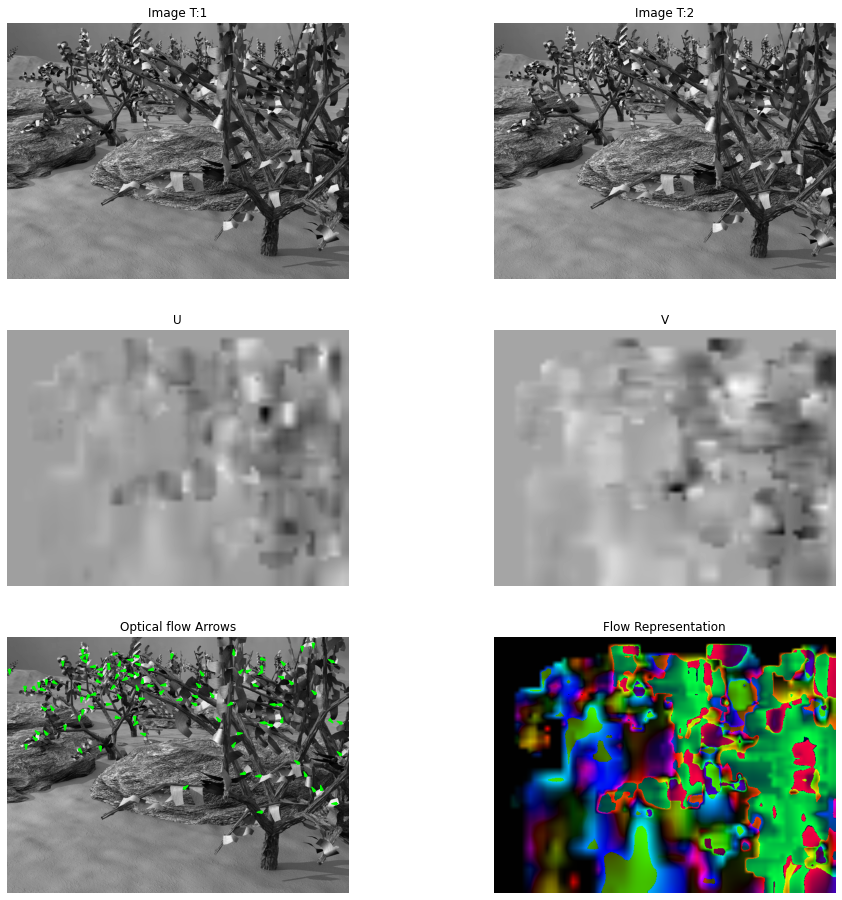

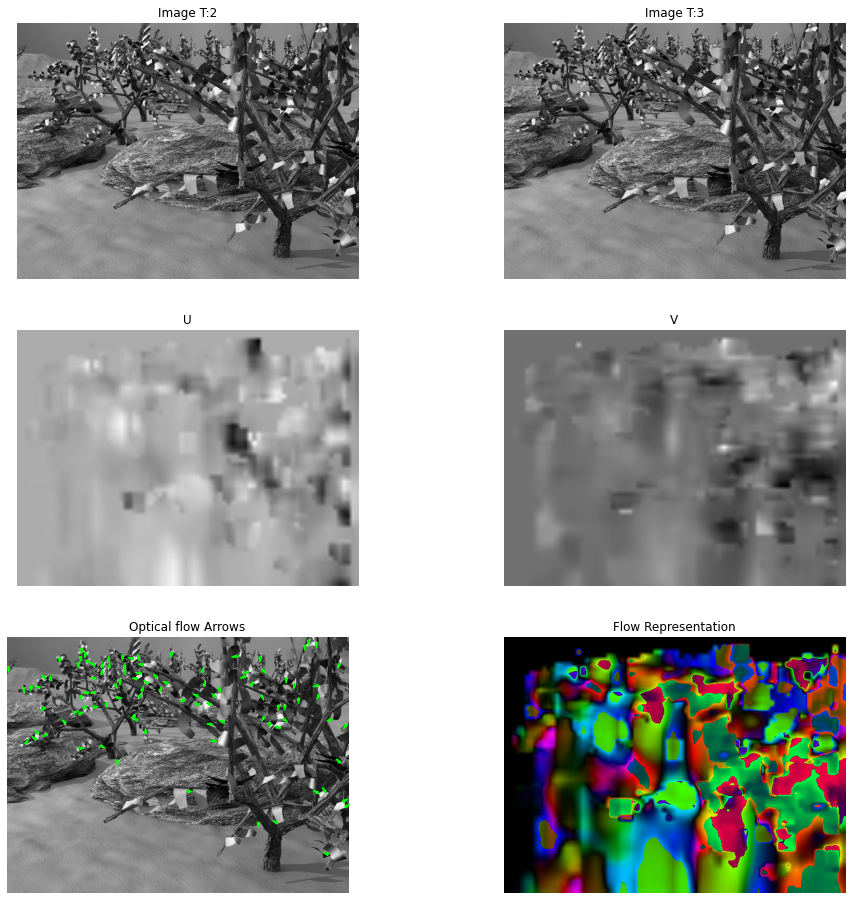

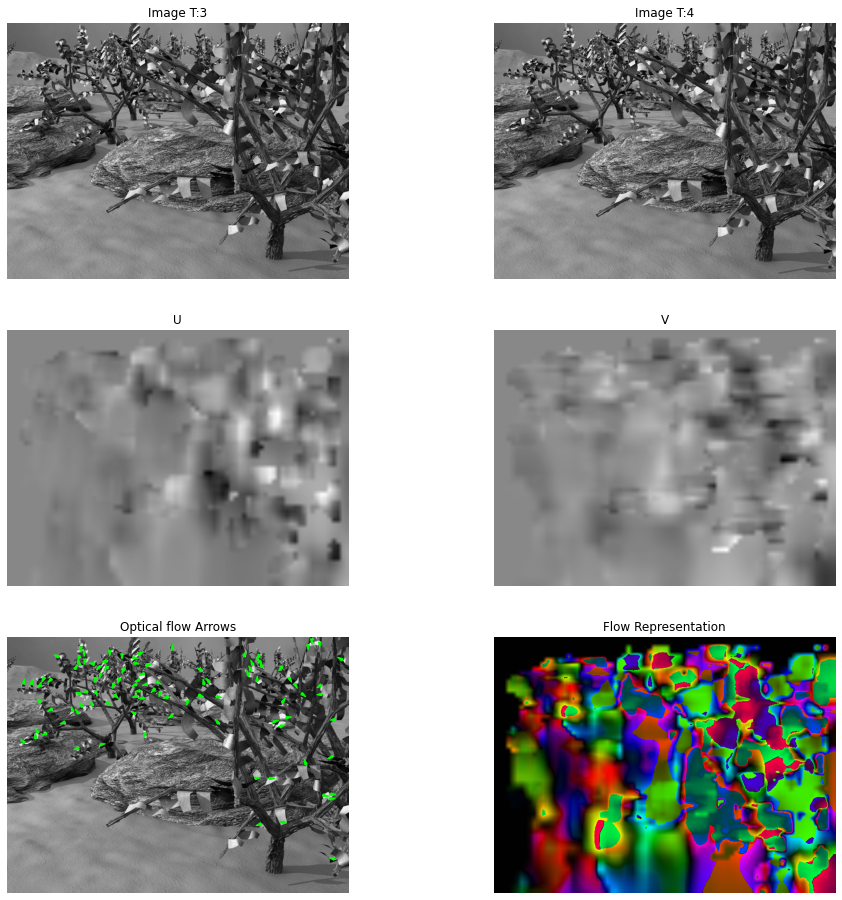

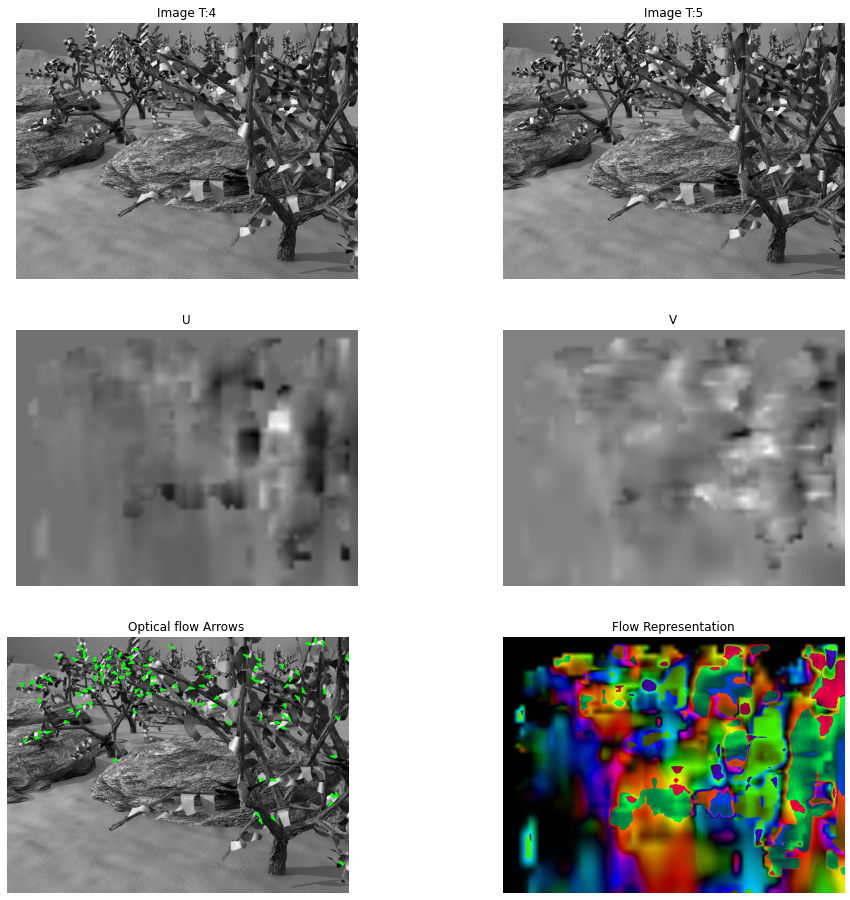

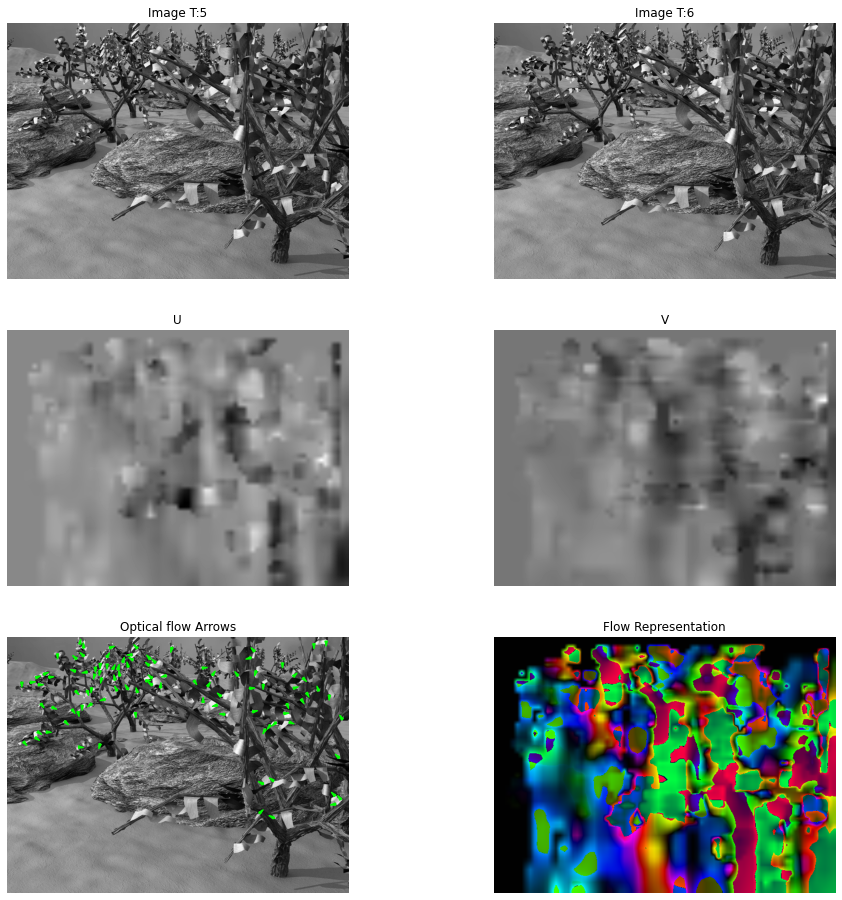

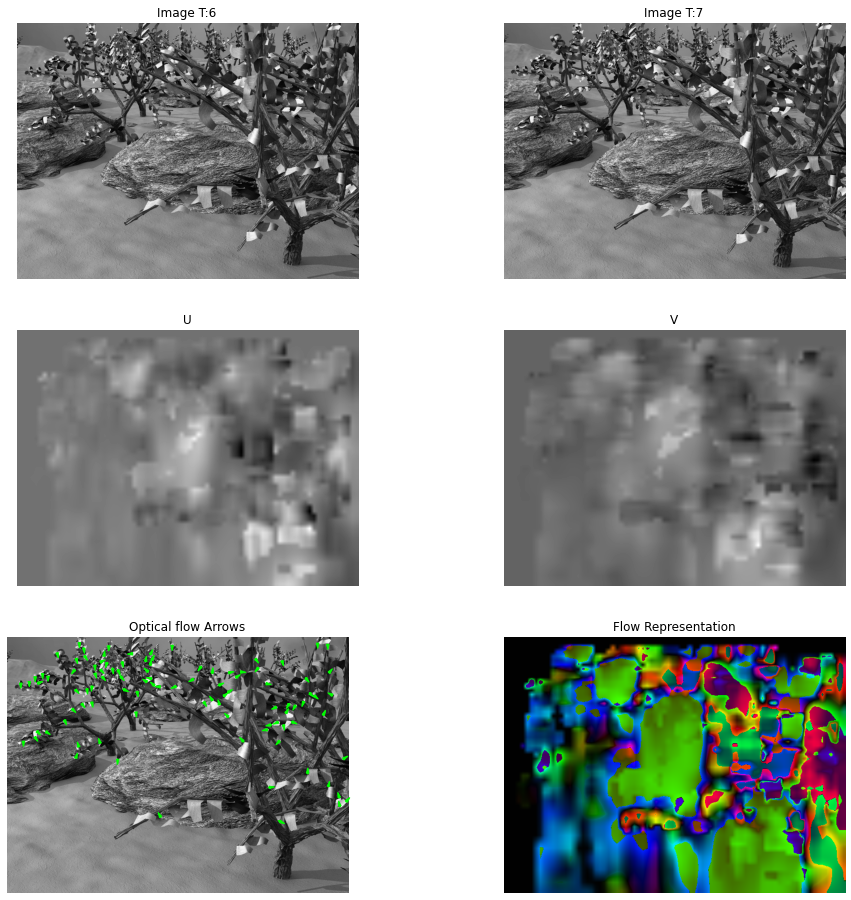

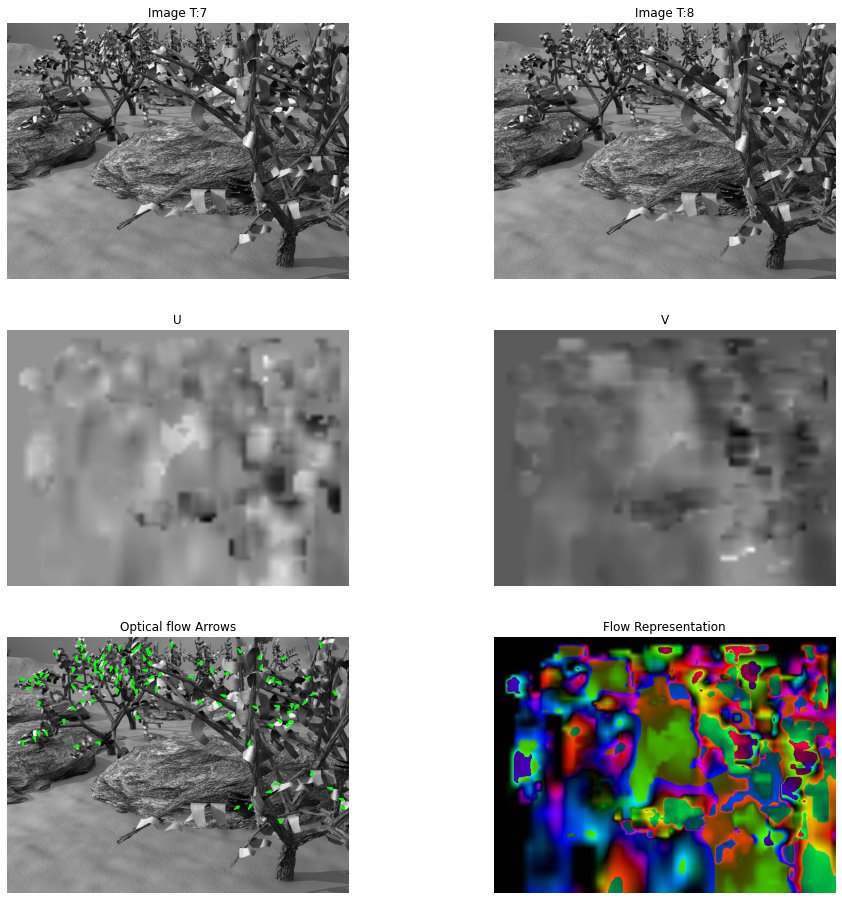

In [23]:
fxn_for_multi('../data/all-frames-colour/Grove3')

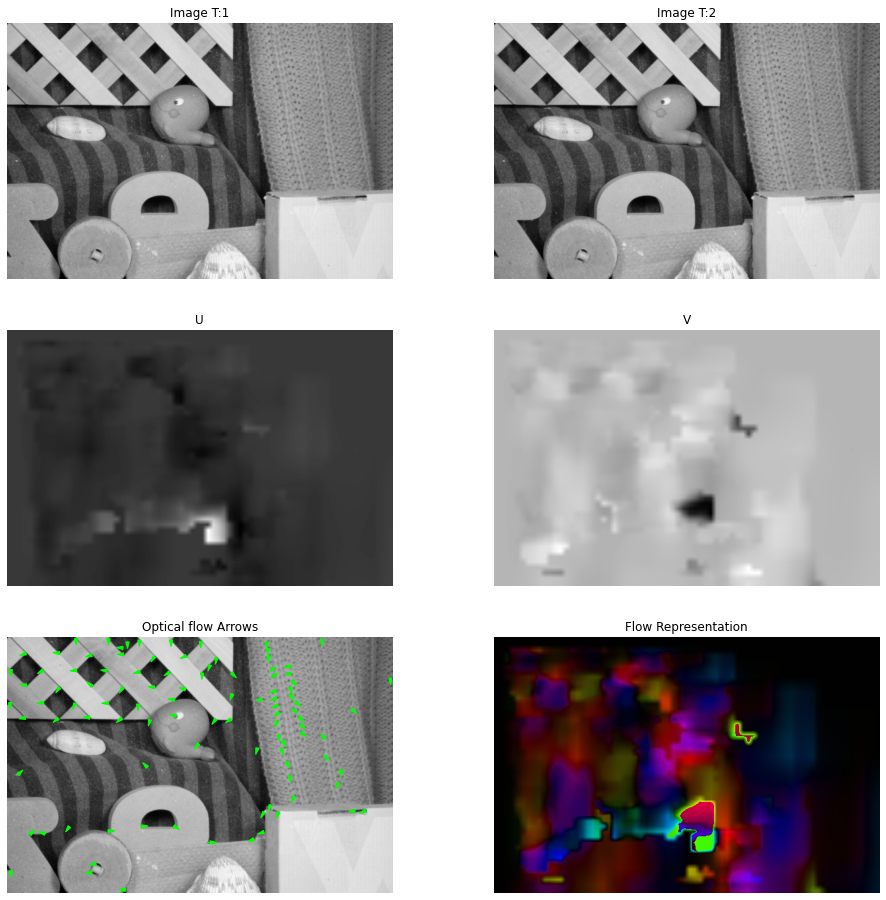

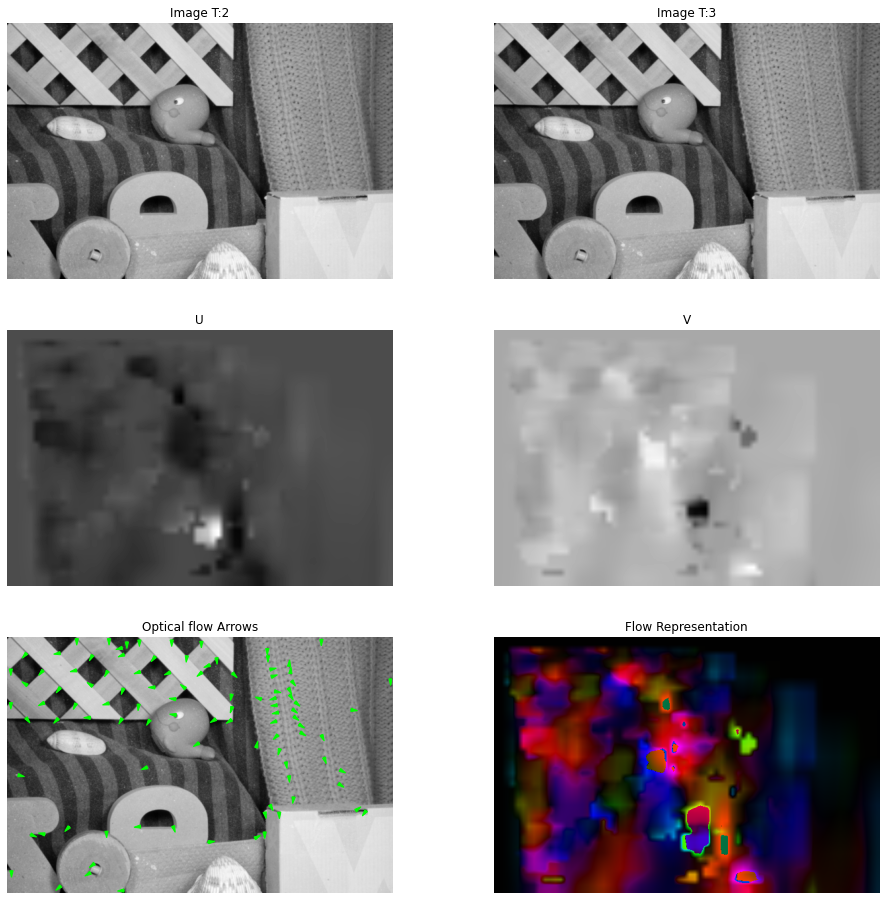

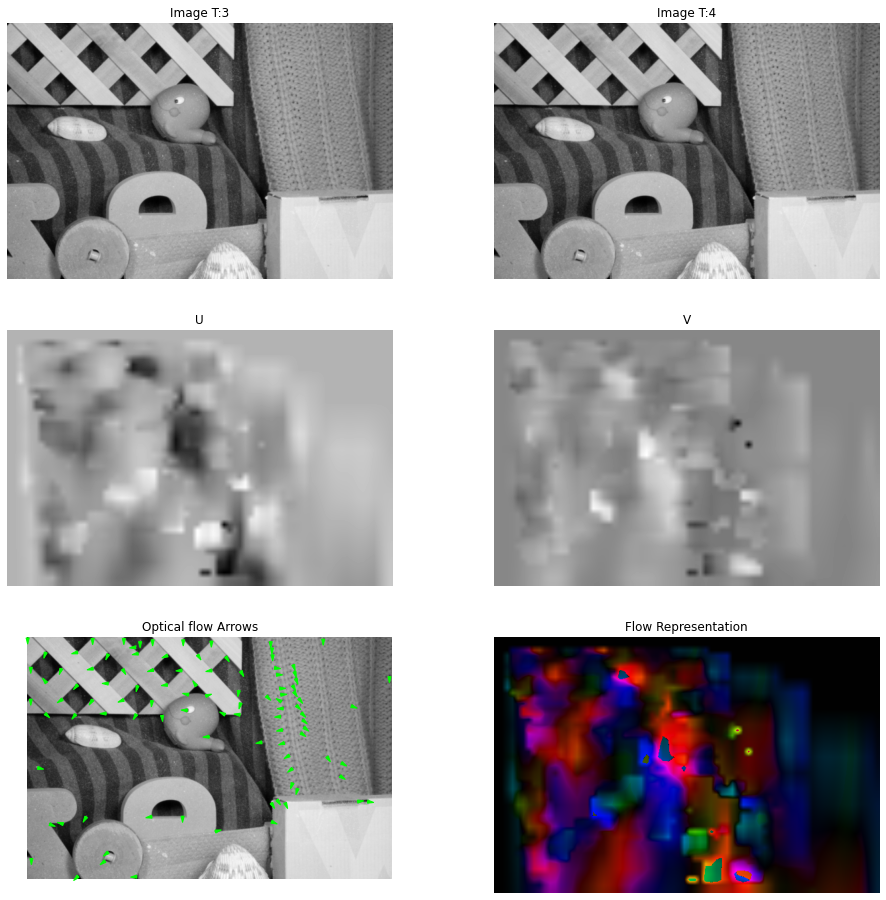

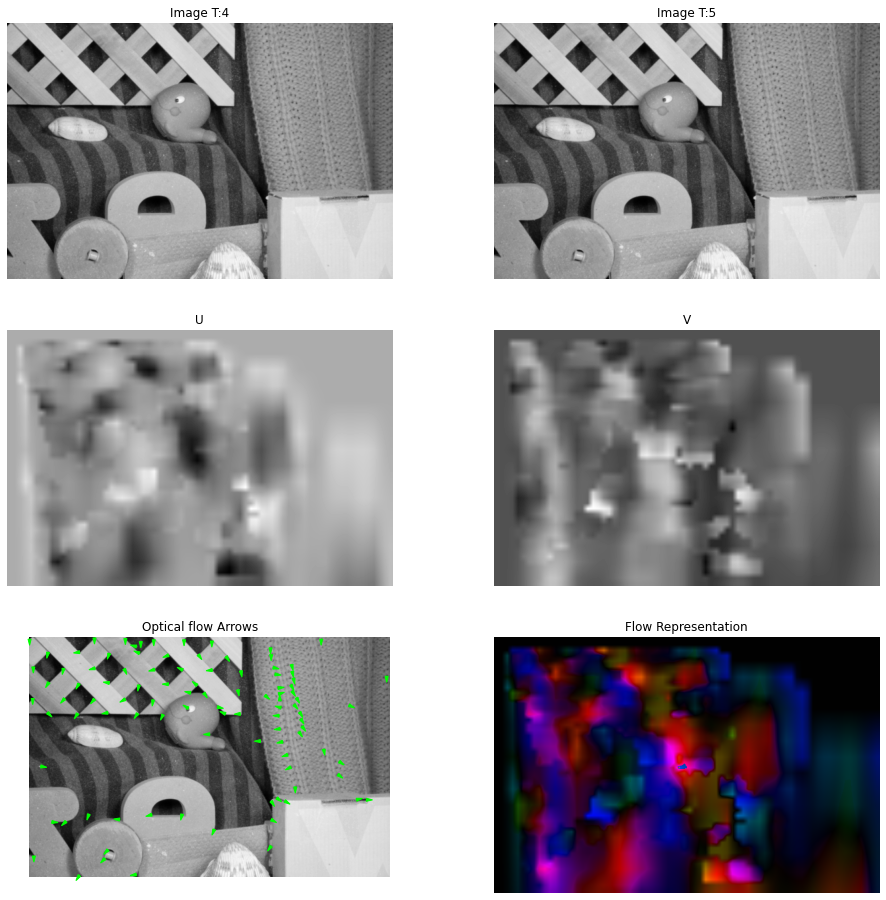

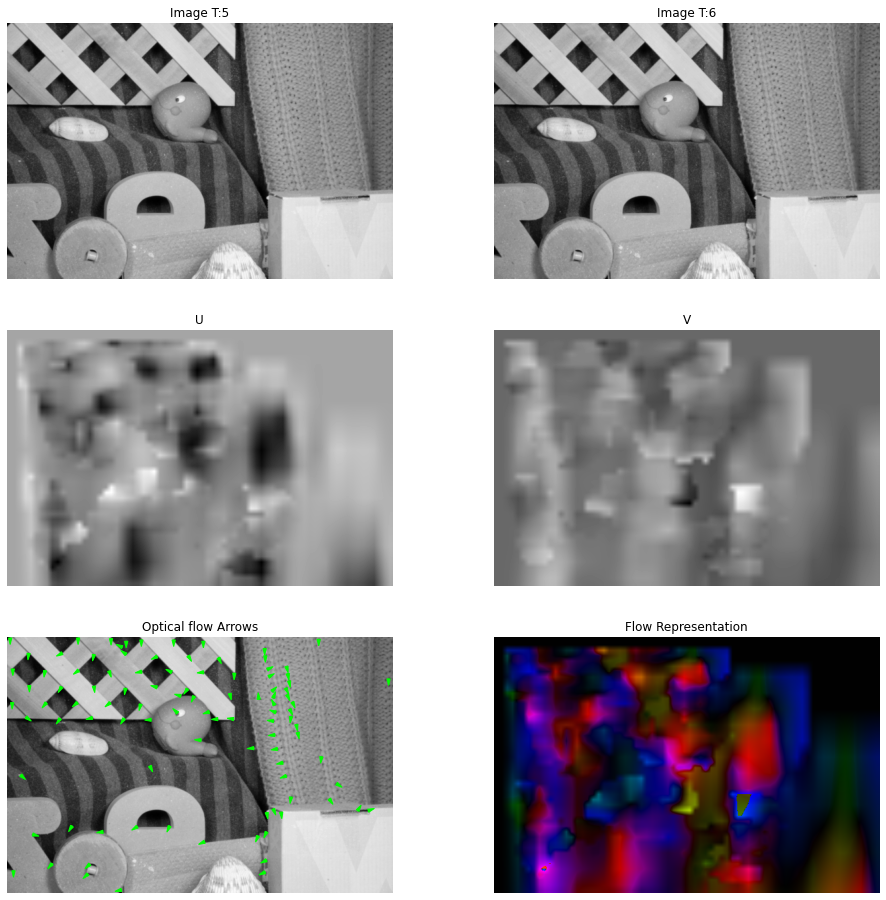

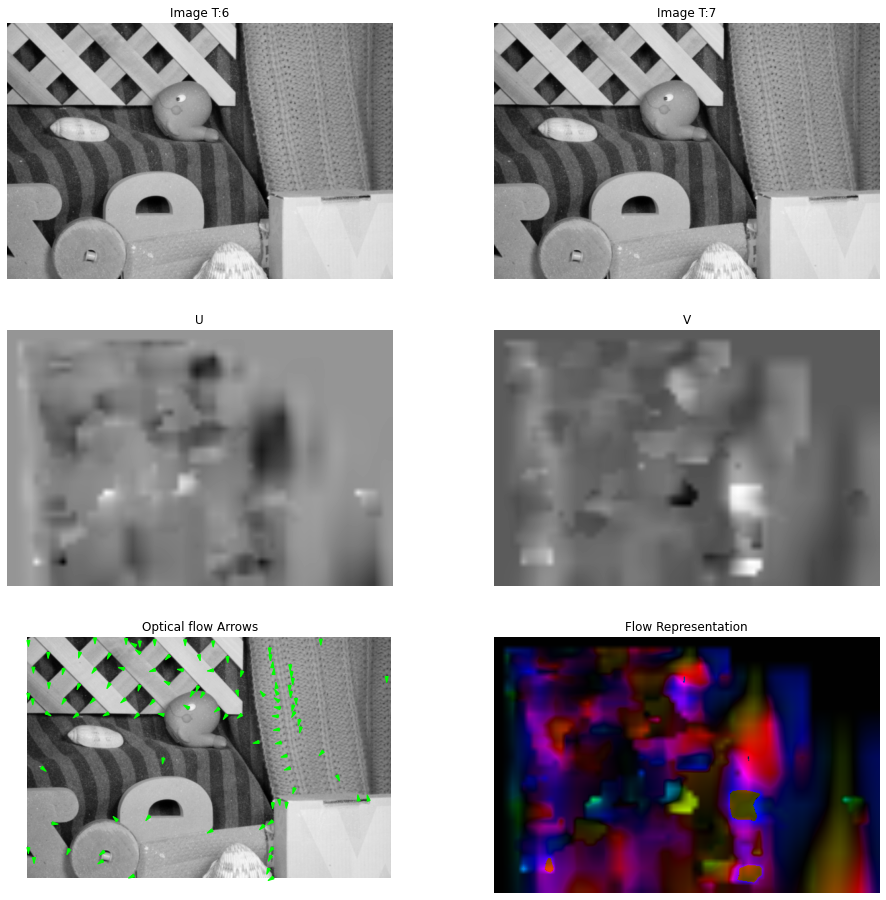

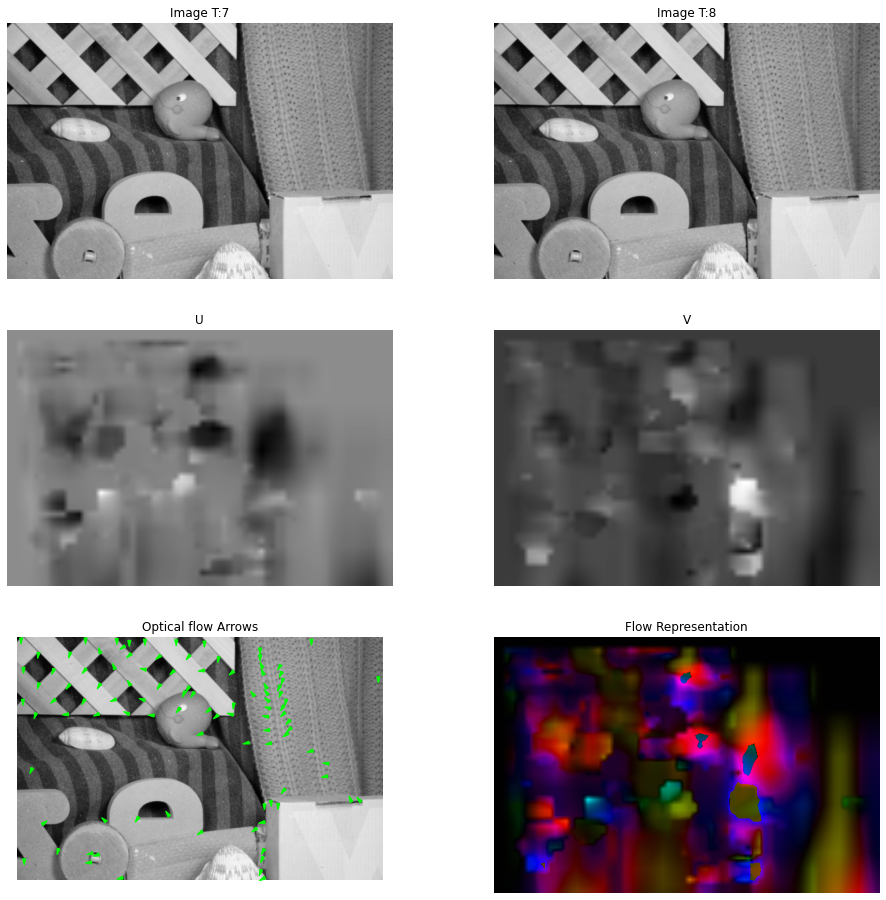

In [24]:
fxn_for_multi('../data/all-frames-colour/RubberWhale')

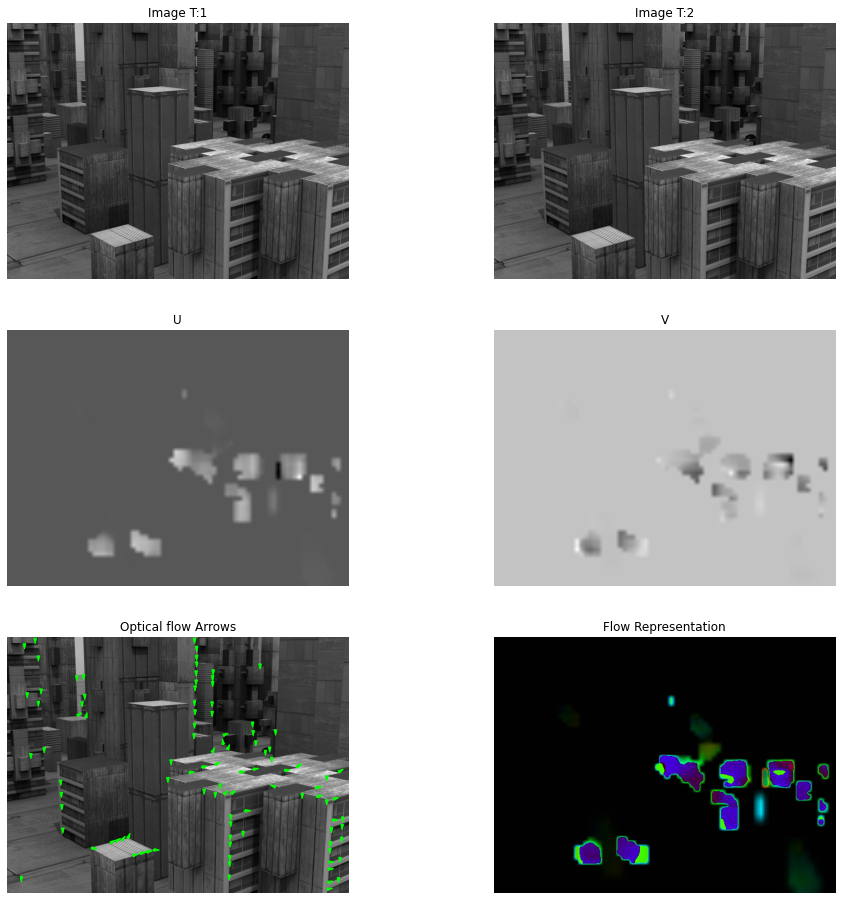

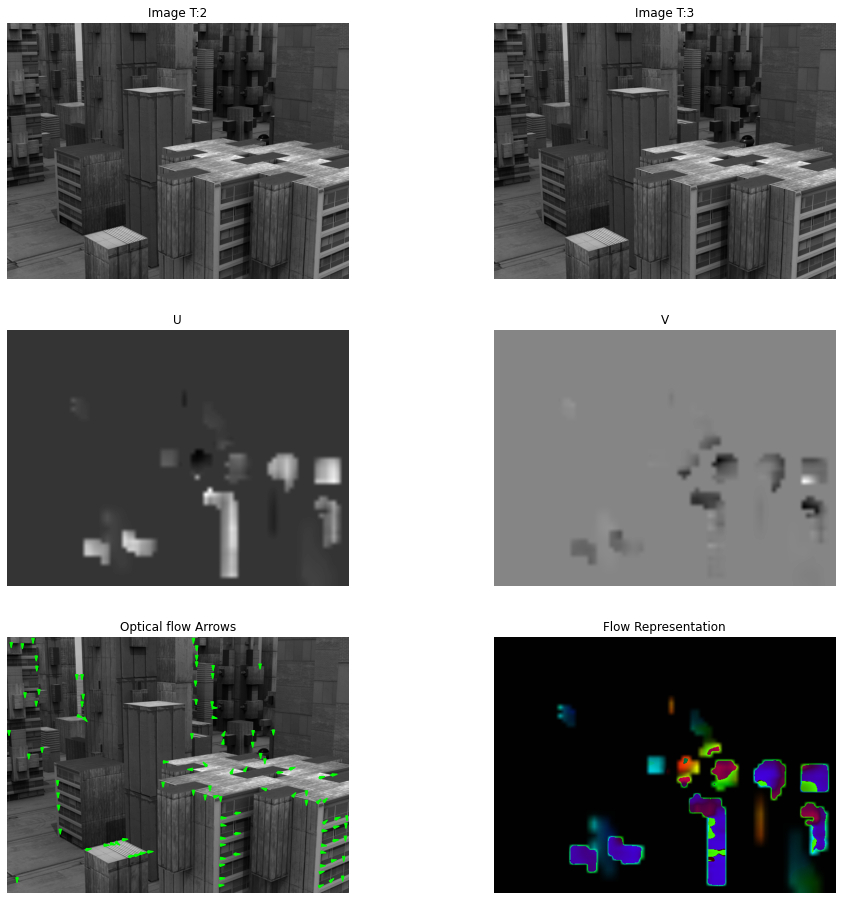

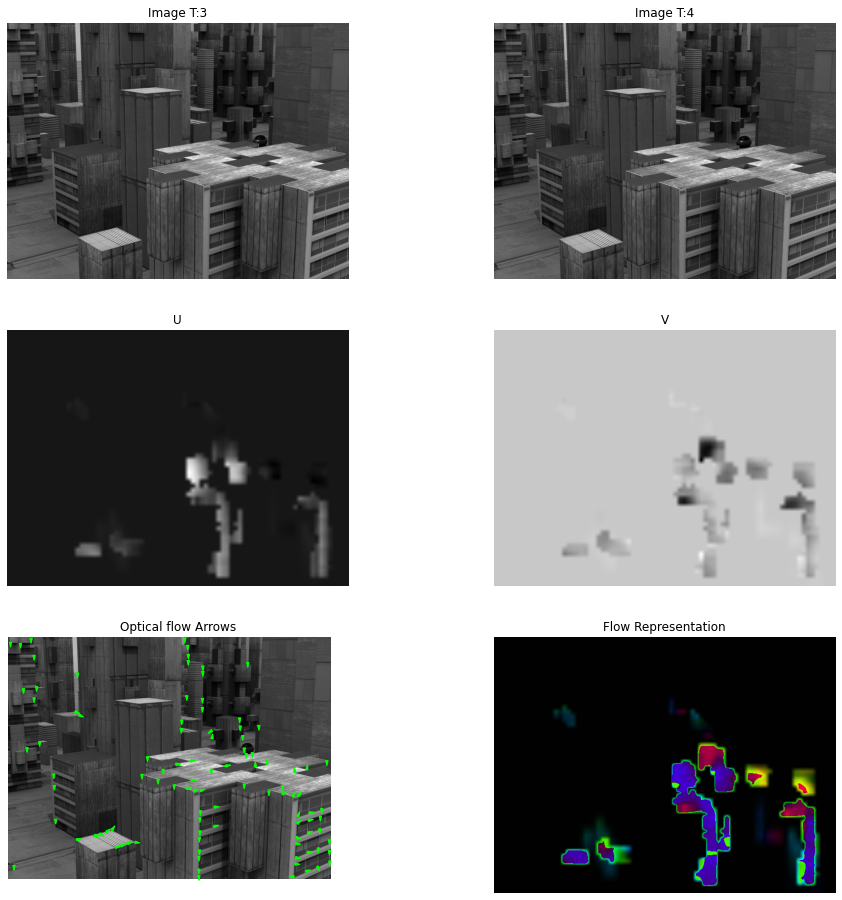

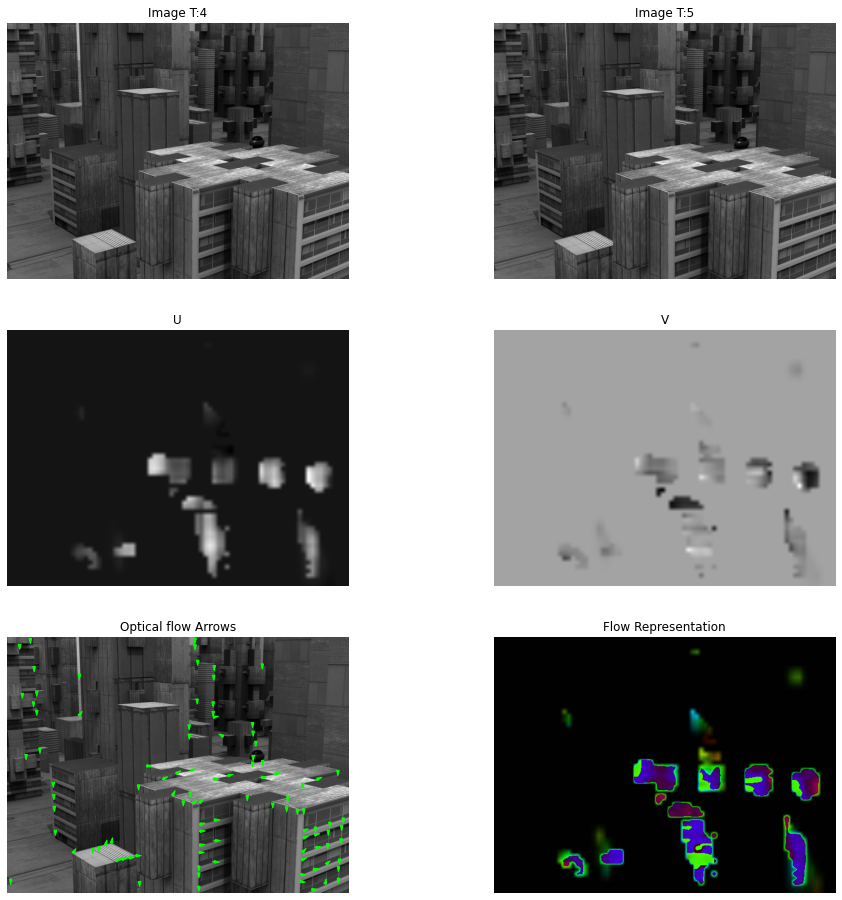

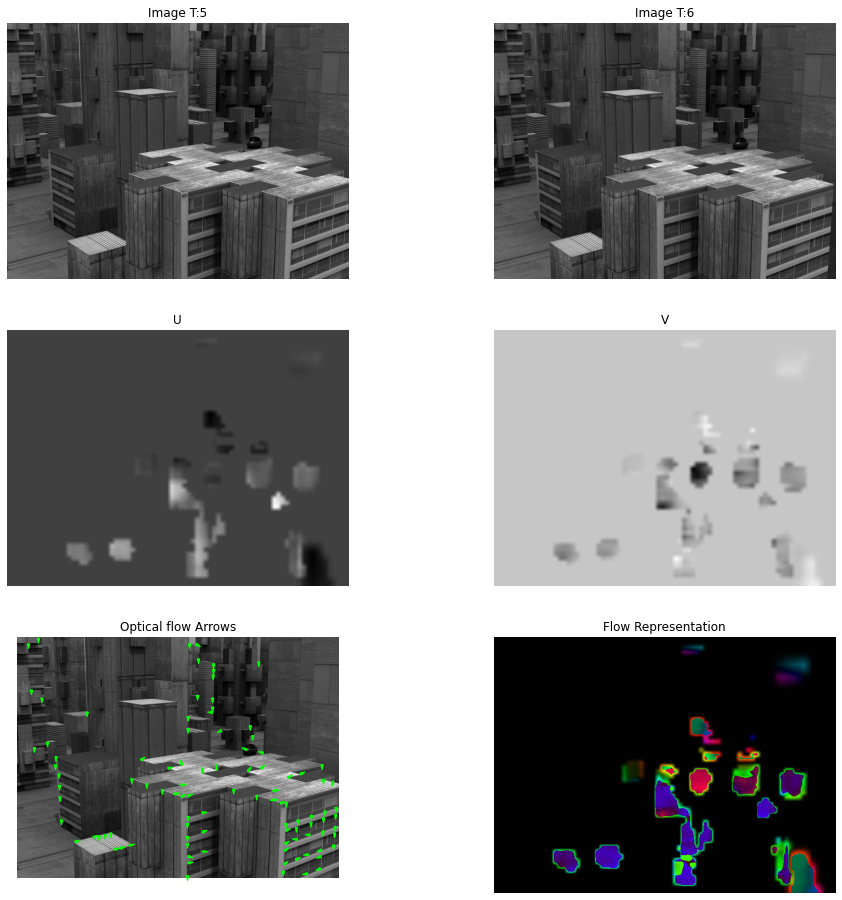

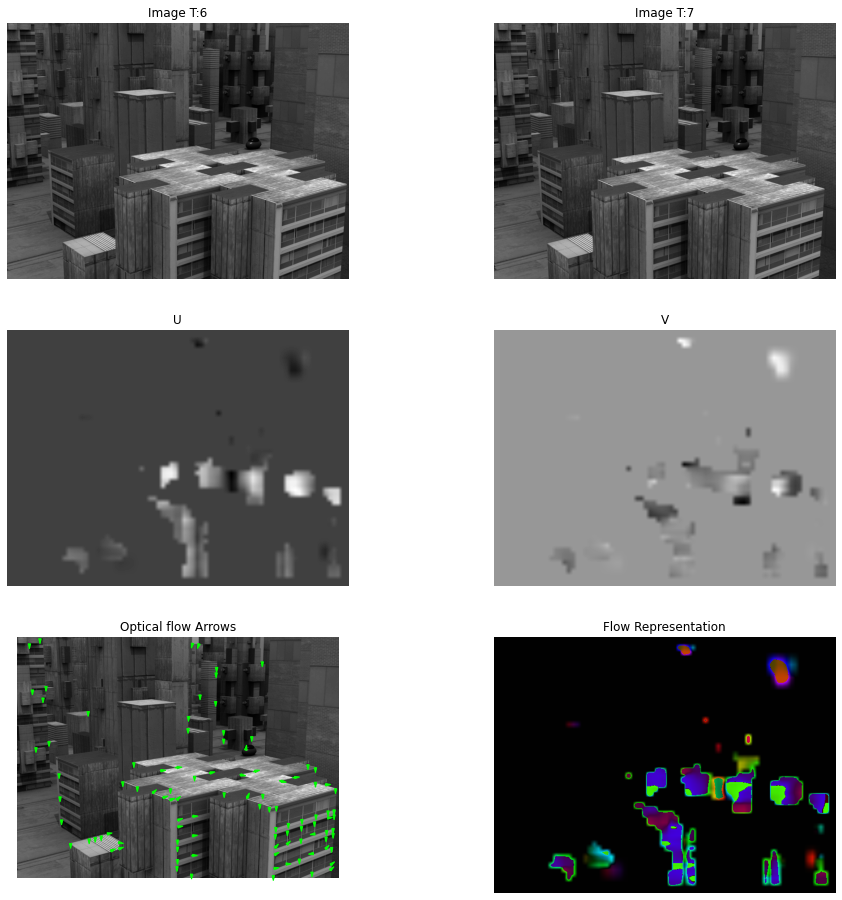

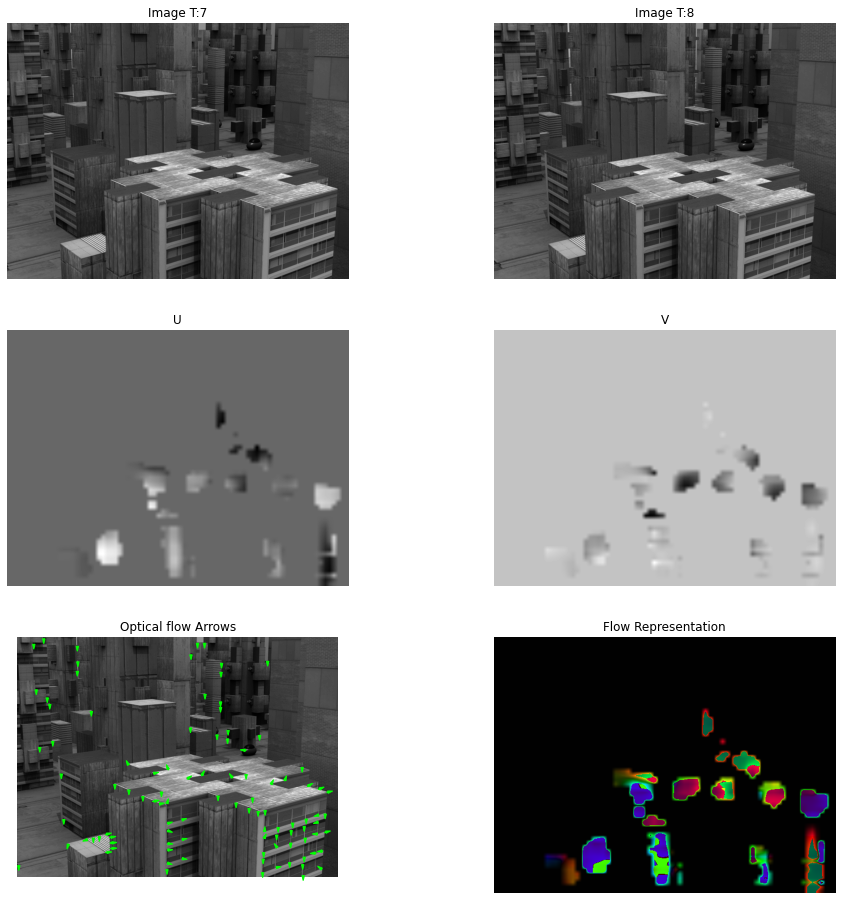

In [26]:
fxn_for_multi('../data/all-frames-colour/Urban2')

### Average End Point Error

In [18]:
aepe = average_end_point_error('../data/ground-truth-flow/Grove3/flow10.flo', '../data/all-frames-colour/Grove3/frame10.png', '../data/all-frames-colour/Grove3/frame11.png',1)
print('Average End Point Error in Grove3 dataset is: ', aepe)

aepe = average_end_point_error('../data/ground-truth-flow/RubberWhale/flow10.flo', '../data/all-frames-colour/RubberWhale/frame10.png', '../data/all-frames-colour/RubberWhale/frame11.png',1)
print('\nAverage End Point Error in RubberWhale dataset is: ', aepe)

aepe = average_end_point_error('../data/ground-truth-flow/Urban2/flow10.flo', '../data/all-frames-colour/Urban2/frame10.png', '../data/all-frames-colour/Urban2/frame10.png',1)
print('Average End Point Error in Urban2 dataset is: ', aepe)

Average End Point Error in Grove3 dataset is:  4.453458924492117

Average End Point Error in RubberWhale dataset is:  68882898.76343736
Average End Point Error in Urban2 dataset is:  1.0799321573861955
